# UnSupervised Learning 

In [151]:
%pylab inline

Populating the interactive namespace from numpy and matplotlib


In [152]:
import seaborn as sns
import pandas as pd
import keras

### Import and analyze IRIS dataset

In [153]:
from sklearn.datasets import load_iris

In [154]:
dataset = load_iris()

In [155]:
dataset.keys()

dict_keys(['data', 'target', 'target_names', 'DESCR', 'feature_names', 'filename'])

In [156]:
X = dataset['data']
feature_names = dataset['feature_names']
y = dataset['target']

print(feature_names)

['sepal length (cm)', 'sepal width (cm)', 'petal length (cm)', 'petal width (cm)']


#### Make data frame for the dataset

In [157]:
df = pd.DataFrame(X,columns=feature_names)
df['target'] = y

In [158]:
df

,sepal length (cm),sepal width (cm),petal length (cm),petal width (cm),target
0,5.1,3.5,1.4,0.2,0
1,4.9,3.0,1.4,0.2,0
2,4.7,3.2,1.3,0.2,0
3,4.6,3.1,1.5,0.2,0
4,5.0,3.6,1.4,0.2,0
5,5.4,3.9,1.7,0.4,0
6,4.6,3.4,1.4,0.3,0
7,5.0,3.4,1.5,0.2,0
8,4.4,2.9,1.4,0.2,0
9,4.9,3.1,1.5,0.1,0


In [159]:
df['target'].unique() # categorical values assigned to the data

array([0, 1, 2], dtype=int64)

#### size of dataset

In [160]:
df.shape

(150, 5)

#### statistics

In [161]:
df.describe()

,sepal length (cm),sepal width (cm),petal length (cm),petal width (cm),target
count,150.000000,150.000000,150.000000,150.000000,150.000000
mean,5.843333,3.057333,3.758000,1.199333,1.000000
std,0.828066,0.435866,1.765298,0.762238,0.819232
min,4.300000,2.000000,1.000000,0.100000,0.000000
25%,5.100000,2.800000,1.600000,0.300000,0.000000
50%,5.800000,3.000000,4.350000,1.300000,1.000000
75%,6.400000,3.300000,5.100000,1.800000,2.000000
max,7.900000,4.400000,6.900000,2.500000,2.000000


In [162]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 150 entries, 0 to 149
Data columns (total 5 columns):
sepal length (cm)    150 non-null float64
sepal width (cm)     150 non-null float64
petal length (cm)    150 non-null float64
petal width (cm)     150 non-null float64
target               150 non-null int32
dtypes: float64(4), int32(1)
memory usage: 5.4 KB


All features are in numerical values. No missing data

sepal length (cm)


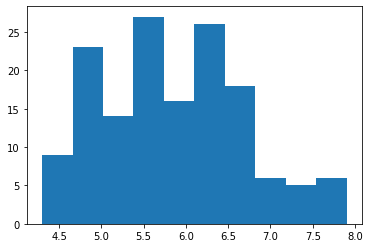

sepal width (cm)


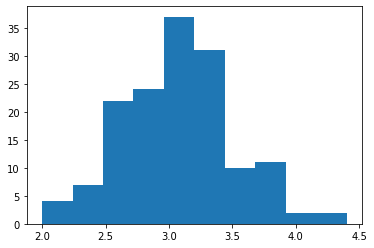

petal length (cm)


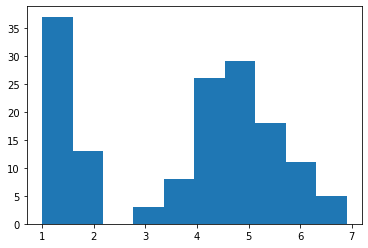

petal width (cm)


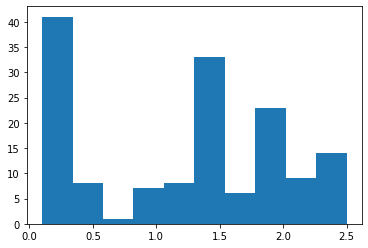

target


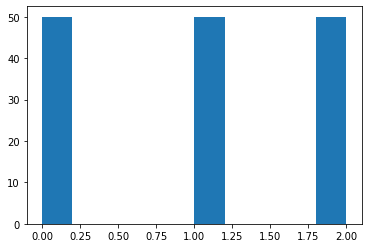

In [163]:
for col in df.columns:
    print(col)
    plt.hist(df[col],10)
    plt.show()

## Visualize dataset

C:\Users\Navyanth\Anaconda3\lib\site-packages\statsmodels\nonparametric\kde.py:487: RuntimeWarning: invalid value encountered in true_divide
  binned = fast_linbin(X, a, b, gridsize) / (delta * nobs)
C:\Users\Navyanth\Anaconda3\lib\site-packages\statsmodels\nonparametric\kdetools.py:34: RuntimeWarning: invalid value encountered in double_scalars
  FAC1 = 2*(np.pi*bw/RANGE)**2


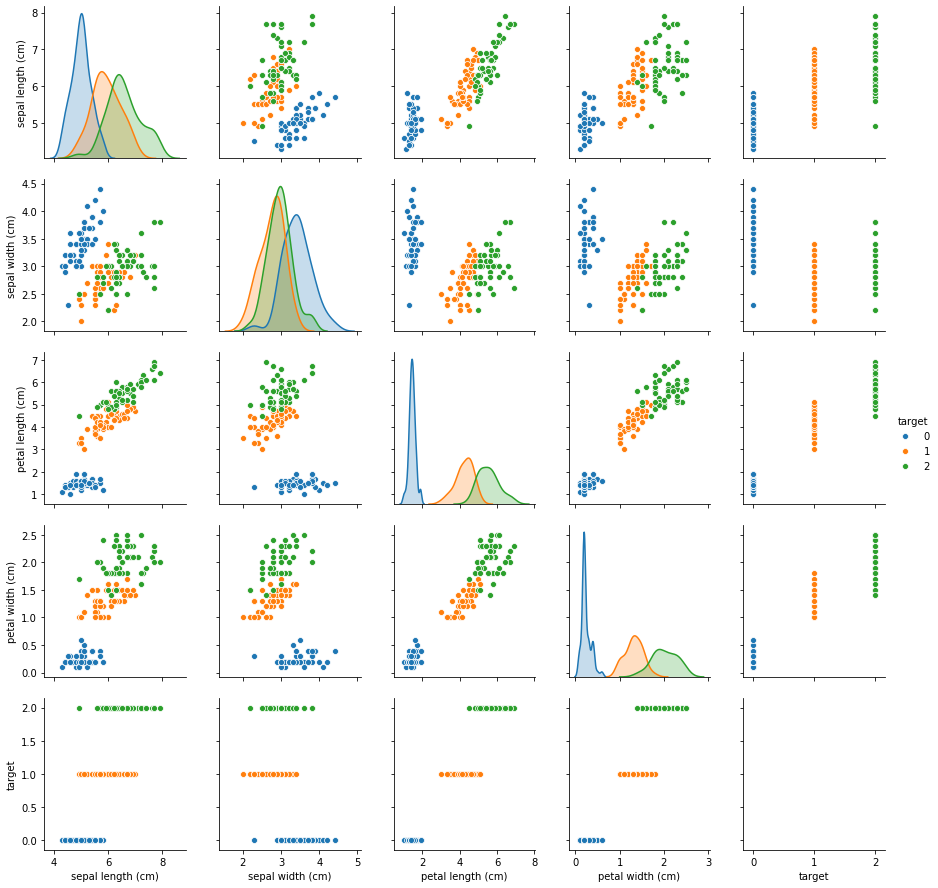

In [33]:
sns.pairplot(df,hue='target')

## Dimensionality reduction techniques

1. PCA

2. NMF

3. SVD

4. t-SNE

5. UMAP

In [164]:
from sklearn.decomposition import PCA, KernelPCA, IncrementalPCA, NMF, TruncatedSVD

In [165]:
from sklearn.manifold import TSNE

#### function to plot the data after clustering

In [166]:
def plot_clustering_2D(clustering_algo):
    '''
    plots the scatter plots with x and y axis as the first and the
    second reduced dimension and colors according to the label
    '''
    out= clustering_algo.fit_transform(X)
    plt.scatter(out[:,0],out[:,1],c=y) 
    plt.show()

In [167]:
X.shape

(150, 4)

### PCA

In [168]:
pca = PCA(n_components=4)
out = pca.fit_transform(X)

In [169]:
out.shape

(150, 4)

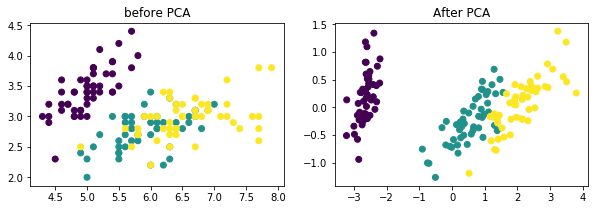

In [170]:
plt.figure(figsize=(10,3))
plt.subplot(1,2,1)
plt.title('before PCA')
plt.scatter(X[:,0],X[:,1],c=y)
plt.subplot(1,2,2)
plt.title('After PCA')
plt.scatter(out[:,0],out[:,1],c=y)
plt.show()

PCA was able to find the correlation in the input variables but not soo good

In [118]:
pca.explained_variance_ratio_

array([0.92461872, 0.05306648, 0.01710261, 0.00521218])

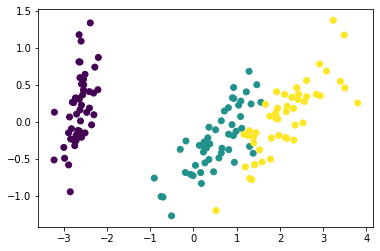

In [171]:
# same operation usng the function
plot_clustering_2D(PCA(n_components=2))

### KernalPCA

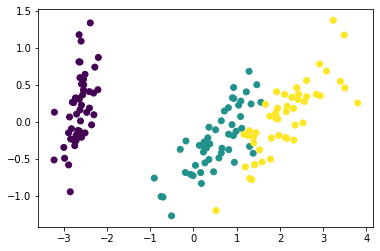

In [172]:
plot_clustering_2D(KernelPCA(n_components=2, kernel='linear'))
# this is same as linear PCA

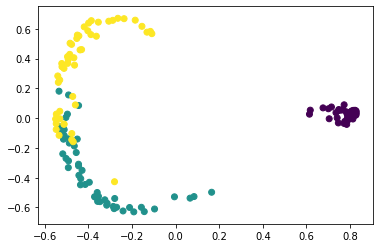

In [173]:
plot_clustering_2D(KernelPCA(n_components=2, kernel='rbf'))
# this is same as linear PCA

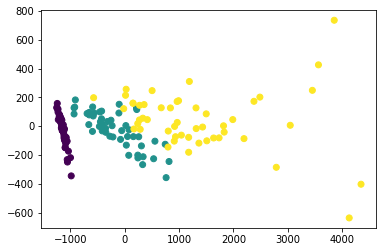

In [174]:
plot_clustering_2D(KernelPCA(n_components=2, kernel='poly', degree=5))
# this is same as linear PCA

### NMF : Non negative matrix factorization

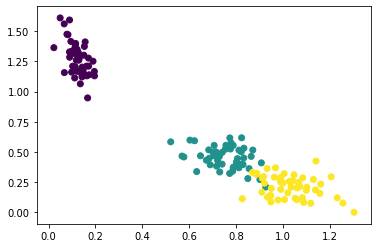

In [123]:
plot_clustering_2D(NMF(n_components=2))

### t-SNE

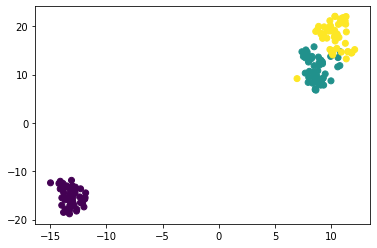

In [124]:
plot_clustering_2D(TSNE(n_components=2,random_state=42))

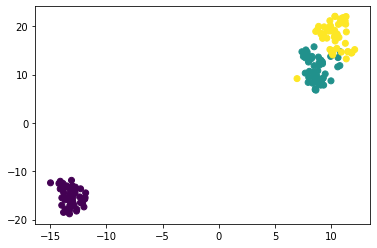

In [125]:
plot_clustering_2D(TSNE(n_components=2,random_state=42,perplexity=30))

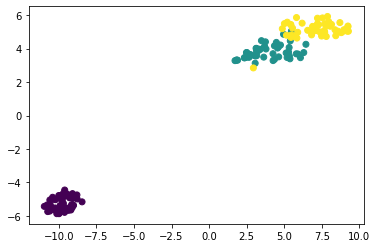

In [76]:
plot_clustering_2D(TSNE(n_components=2,random_state=42,perplexity=50))

## Clustering

In [127]:
from sklearn.metrics import homogeneity_score

### KMeans

In [128]:
from sklearn.cluster import KMeans

In [129]:
kmeans = KMeans(n_clusters=3,random_state=1)

In [130]:
# predicted labels
y_pred = kmeans.fit_predict(X)

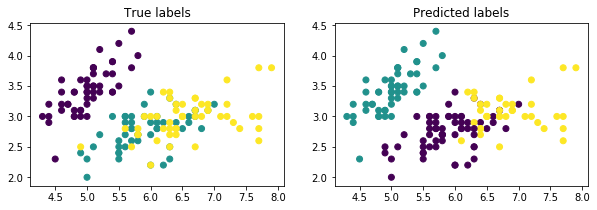

In [131]:
plt.figure(figsize=(10,3))
plt.subplot(1,2,1)
plt.title('True labels')
plt.scatter(X[:,0],X[:,1],c=y)
plt.subplot(1,2,2)
plt.title('Predicted labels')
plt.scatter(X[:,0],X[:,1],c=y_pred)
plt.show()

#### Method to find the number of clusters for KMeans

In [132]:
inertias = []
scores = []

for n_cluster in range(1,10):
    kmeans = KMeans(n_clusters=n_cluster)
    y_pred = kmeans.fit_predict(X)
    scores.append(homogeneity_score(y,y_pred))
    inertias.append(kmeans.inertia_)

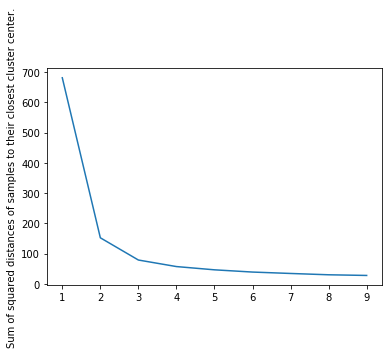

In [137]:
plt.plot(list(range(1,10)),inertias)
plt.ylabel('Sum of squared distances of samples to their closest cluster center.')
plt.show()

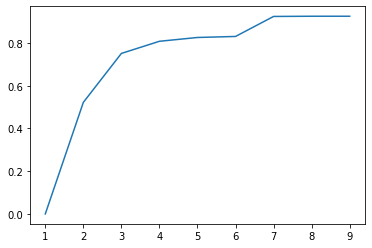

In [134]:
plt.plot(list(range(1,10)),scores)

### DBSCAN: Density Based Algorithm

In [135]:
from sklearn.cluster import DBSCAN

In [138]:
db_scores = []
epss = np.linspace(0.01,1)
for eps in epss:
    dbscan = DBSCAN(eps=eps)
    y_pred = dbscan.fit_predict(X)
    db_scores.append(homogeneity_score(y,y_pred))

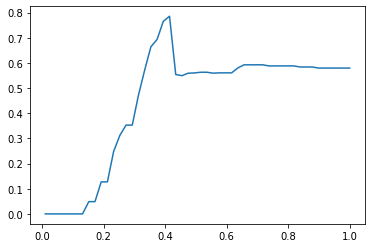

In [139]:
plt.plot(epss, db_scores)

In [140]:
dbscan = DBSCAN(eps=0.4)
y_pred = dbscan.fit_predict(X)

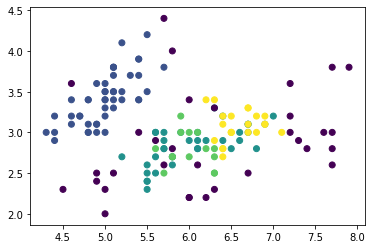

In [141]:
plt.scatter(X[:,0],X[:,1], c=y_pred)

### Gaussian Mixure

In [142]:
from sklearn.mixture import GaussianMixture

In [143]:
gm_scores = []
aics = []
bics = []
n_clusters = list(range(1,10))

for n_cluster in n_clusters:
    gm = GaussianMixture(n_components=n_cluster,verbose=0)
    y_pred = gm.fit_predict(X)
    gm_scores.append(homogeneity_score(y,y_pred))
    aics.append(gm.aic(X))
    bics.append(gm.bic(X))

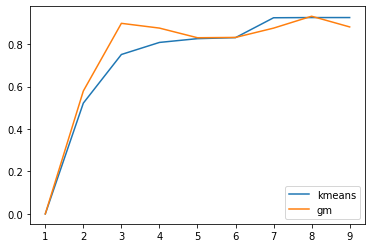

In [144]:
plt.plot(n_clusters, scores, label='kmeans')
plt.plot(n_clusters, gm_scores, label='gm')
plt.legend()

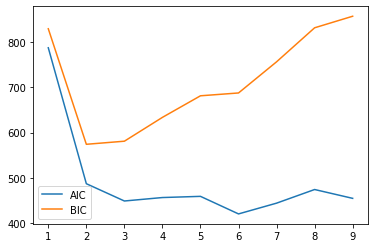

In [145]:
plt.plot(n_clusters, aics, label='AIC')
plt.plot(n_clusters, bics, label='BIC')
plt.legend()

### The above plot can be used to select number of lusters

In [146]:
gm = GaussianMixture(n_components=3, verbose=0)
y_pred = gm.fit_predict(X)

In [147]:
homogeneity_score(y,y_pred)

0.8983263672602775

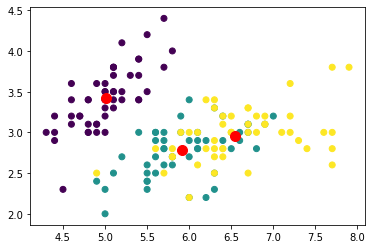

In [149]:
plt.scatter(X[:,0],X[:,1], c=y)
plt.scatter(gm.means_[:,0], gm.means_[:,1], marker='o', color='red', s=100)
plt.show()

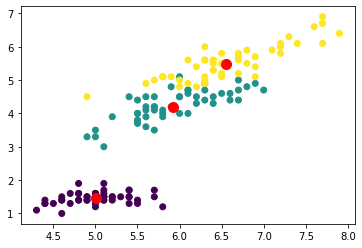

In [150]:
plt.scatter(X[:,0],X[:,2], c=y)
plt.scatter(gm.means_[:,0], gm.means_[:,2], marker='o', color='red', s=100)
plt.show()

## Materials Project Data

Results of DFT simulation data extracted from Materials project 
https://materialsproject.org

In [175]:
df = pd.read_csv('materials_project_data.csv')

In [176]:
df.head()

,structure_id,COMPOSITION,NUMBER_OF_ATOMS,e_above_hull,band_gap,total_magnetization,formation_energy_per_atom,density,magnetization_per_atom,nuH,...,Tl,Tm,U,V,W,Xe,Y,Yb,Zn,Zr
0,304742,Fe-2 N-6 Sr-6,14,0.000000,0.0000,4.160592e+00,-0.817217,4.448535,2.971851e-01,0.260710,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,311952,Pt-21 Ti-7,28,0.000000,0.0000,1.482900e-03,-0.859812,17.027462,5.296071e-05,0.302075,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,305877,Ga-2 In-2 Te-4,8,0.038644,0.0000,8.710000e-05,-0.295817,5.831028,1.088750e-05,0.252565,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,306089,As-2 Ba-1 Co-2,5,0.000000,0.0009,-9.967188e-01,-0.611376,6.678675,1.993438e-01,0.288910,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,305559,Ca-2 O-6 Pt-2,10,0.010892,1.2796,9.000000e-07,-2.000892,7.918129,9.000000e-08,0.299680,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [179]:
a = df.columns

In [186]:
a[-90:]

Index(['elements', 'Ac', 'Ag', 'Al', 'Ar', 'As', 'Au', 'B', 'Ba', 'Be', 'Bi',
       'Br', 'C', 'Ca', 'Cd', 'Ce', 'Cl', 'Co', 'Cr', 'Cs', 'Cu', 'Dy', 'Er',
       'Eu', 'F', 'Fe', 'Ga', 'Gd', 'Ge', 'H', 'He', 'Hf', 'Hg', 'Ho', 'I',
       'In', 'Ir', 'K', 'Kr', 'La', 'Li', 'Lu', 'Mg', 'Mn', 'Mo', 'N', 'Na',
       'Nb', 'Nd', 'Ne', 'Ni', 'Np', 'O', 'Os', 'P', 'Pa', 'Pb', 'Pd', 'Pm',
       'Pr', 'Pt', 'Pu', 'Rb', 'Re', 'Rh', 'Ru', 'S', 'Sb', 'Sc', 'Se', 'Si',
       'Sm', 'Sn', 'Sr', 'Ta', 'Tb', 'Tc', 'Te', 'Th', 'Ti', 'Tl', 'Tm', 'U',
       'V', 'W', 'Xe', 'Y', 'Yb', 'Zn', 'Zr'],
      dtype='object')

In [177]:
df.shape

(7321, 106)

In [188]:
elements = ['Ac', 'Ag', 'Al', 'Ar', 'As', 'Au', 'B', 'Ba', 'Be', 'Bi', 'Br', 'C', 'Ca', 'Cd', 'Ce', 'Cl', 'Co', 'Cr', 'Cs', 'Cu', 'Dy', 'Er', 'Eu', 'F', 'Fe', 'Ga', 'Gd', 'Ge', 'H', 'He', 'Hf', 'Hg', 'Ho', 'I', 'In', 'Ir', 'K', 'Kr', 'La', 'Li', 'Lu', 'Mg', 'Mn', 'Mo', 'N', 'Na', 'Nb', 'Nd', 'Ne', 'Ni', 'Np', 'O', 'Os', 'P', 'Pa', 'Pb', 'Pd', 'Pm', 'Pr', 'Pt', 'Pu', 'Rb', 'Re', 'Rh', 'Ru', 'S', 'Sb', 'Sc', 'Se', 'Si', 'Sm', 'Sn', 'Sr', 'Ta', 'Tb', 'Tc', 'Te', 'Th', 'Ti', 'Tl', 'Tm', 'U', 'V', 'W', 'Xe', 'Y', 'Yb', 'Zn', 'Zr']

In [190]:
a[:20]

Index(['structure_id', 'COMPOSITION', 'NUMBER_OF_ATOMS', 'e_above_hull',
       'band_gap', 'total_magnetization', 'formation_energy_per_atom',
       'density', 'magnetization_per_atom', 'nuH', 'GH', 'EH', 'AVR', 'BH',
       'comp_dict', 'norm_comp_dict', 'elements', 'Ac', 'Ag', 'Al'],
      dtype='object')

In [191]:
prop_columns = ['band_gap','magnetization_per_atom','BH','GH','EH']

In [192]:
X= df[elements]

### Task: Dimensionality reduction to two dimension

In [197]:
from sklearn.manifold import TSNE

In [198]:
tsne = TSNE(n_components=2,random_state=42, init='pca', verbose=2,
           n_iter=500, learning_rate=100., perplexity=100., 
            n_iter_without_progress=50)

In [199]:
X_tr_tsne = tsne.fit_transform(X)

[t-SNE] Computing 301 nearest neighbors...
[t-SNE] Indexed 7321 samples in 0.297s...
[t-SNE] Computed neighbors for 7321 samples in 8.559s...
[t-SNE] Computed conditional probabilities for sample 1000 / 7321
[t-SNE] Computed conditional probabilities for sample 2000 / 7321
[t-SNE] Computed conditional probabilities for sample 3000 / 7321
[t-SNE] Computed conditional probabilities for sample 4000 / 7321
[t-SNE] Computed conditional probabilities for sample 5000 / 7321
[t-SNE] Computed conditional probabilities for sample 6000 / 7321
[t-SNE] Computed conditional probabilities for sample 7000 / 7321
[t-SNE] Computed conditional probabilities for sample 7321 / 7321
[t-SNE] Mean sigma: 0.233290
[t-SNE] Computed conditional probabilities in 1.299s
[t-SNE] Iteration 50: error = 74.9272919, gradient norm = 0.0007761 (50 iterations in 5.529s)
[t-SNE] Iteration 100: error = 74.6345444, gradient norm = 0.0003207 (50 iterations in 5.502s)
[t-SNE] Iteration 150: error = 74.6026459, gradient norm = 

In [201]:
X.shape

(7321, 89)

In [200]:
X_tr_tsne.shape

(7321, 2)

#### Visualize the dataet

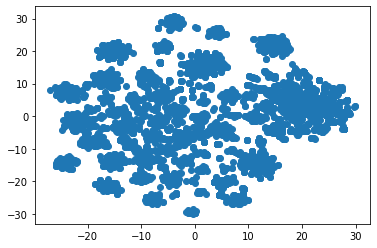

In [202]:

plt.scatter(X_tr_tsne[:,0],X_tr_tsne[:,1])
plt.show()

#### clustering with DBSCAN on the 2D representation of above

In [203]:
cluster = DBSCAN()
labels = cluster.fit_predict(X_tr_tsne)

In [205]:
labels.shape

(7321,)

No of clusters found: 243
fraction of classified objects: 0.8778855347630106


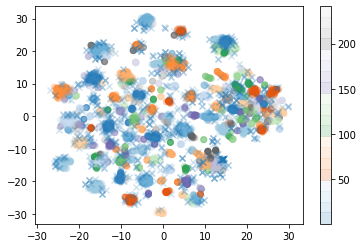

In [213]:
print('No of clusters found:', len(set(labels)))
# label -1 corresponds to un classified object
mask=labels>0
print('fraction of classified objects:', np.mean(mask))
# plotting the data only identified as clusters by DBSCAN in the tSNE prediction
plt.scatter(X_tr_tsne[mask,0],X_tr_tsne[mask,1],c=labels[mask], cmap='tab20c',alpha=0.2)
plt.colorbar()
# plotting the rest
plt.scatter(X_tr_tsne[~mask,0],X_tr_tsne[~mask,1],marker='x',alpha=0.2)
plt.show()

## ToDo
1. Try different values of inter object distances (eps) and number of minimum samples in a cluster(min_samples) to have a reasonable clustering

In [214]:
cluster = DBSCAN(eps=0.4, min_samples=20)
labels = cluster.fit_predict(X_tr_tsne)

No of clusters found: 78
fraction of classified objects: 0.3894276738150526


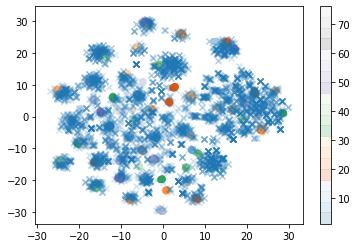

In [215]:
print('No of clusters found:', len(set(labels)))
# label -1 corresponds to un classified object
mask=labels>0
print('fraction of classified objects:', np.mean(mask))
# plotting the data only identified as clusters by DBSCAN in the tSNE prediction
plt.scatter(X_tr_tsne[mask,0],X_tr_tsne[mask,1],c=labels[mask], cmap='tab20c',alpha=0.2)
plt.colorbar()
# plotting the rest
plt.scatter(X_tr_tsne[~mask,0],X_tr_tsne[~mask,1],marker='x',alpha=0.2)
plt.show()

#### Visualize each cluster separetely

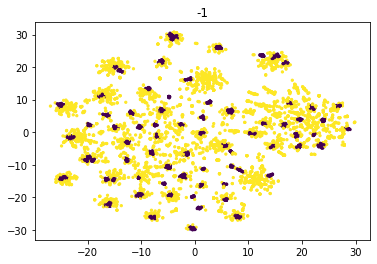

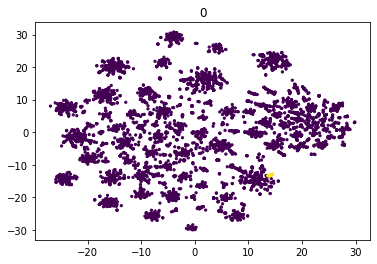

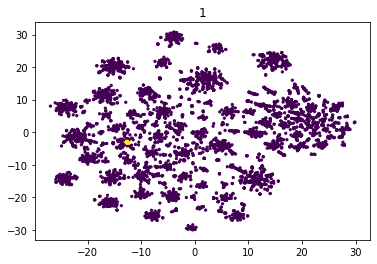

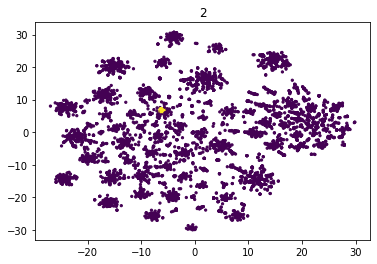

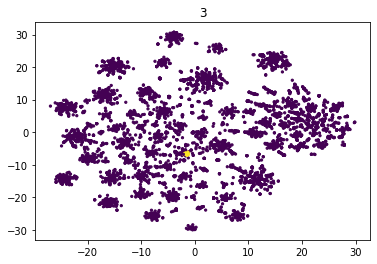

...

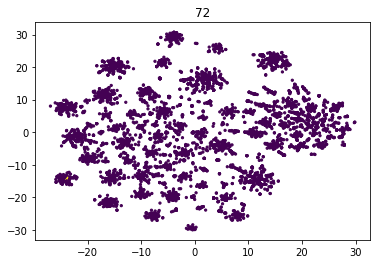

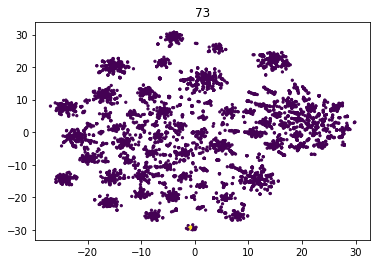

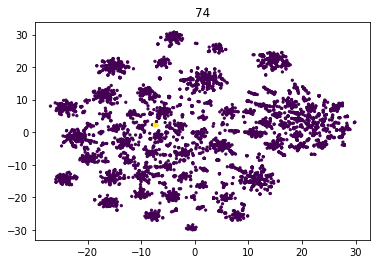

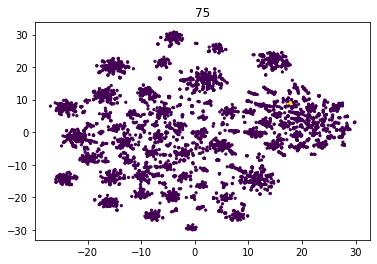

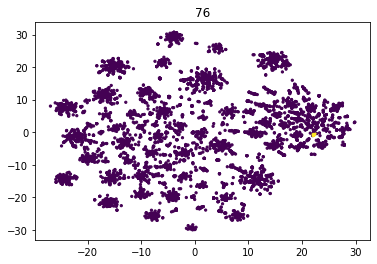

In [219]:
for lab in np.unique(labels):
    label_mask=labels==lab
    plt.scatter(X_tr_tsne[:,0],X_tr_tsne[:,1],c=label_mask,s=5)
    plt.title(lab)
    plt.show()

#### plot to highlight each element concentration on a separate plot

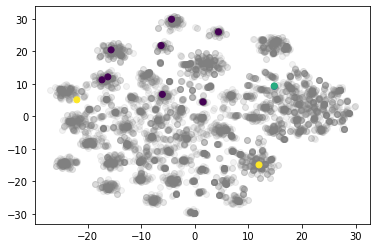

In [240]:
#example for 'AC': identifying all the data points which has 'AC' inthem
AC_mask = df['Ac']>0
# all except the data with  'AC' in it
plt.scatter(X_tr_tsne[~AC_mask,0],X_tr_tsne[~AC_mask,1],alpha=0.1,color='gray')
#all data with element 'AC' in it and color it according to the percentage
plt.scatter(X_tr_tsne[AC_mask,0],X_tr_tsne[AC_mask,1],c=np.log1p(df.loc[AC_mask,'Ac']))
plt.show()

Element:  Ac


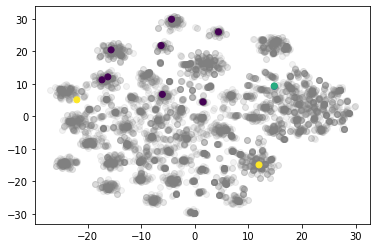

Element:  Ag


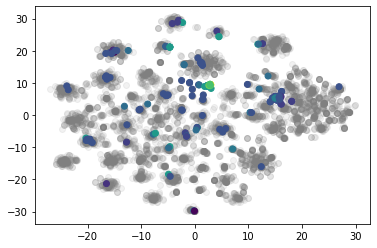

Element:  Al


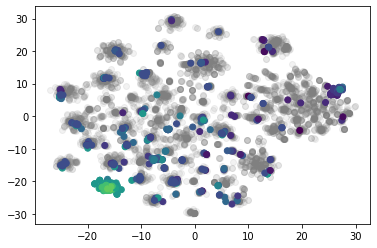

Element:  Ar


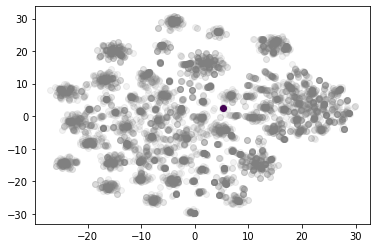

Element:  As


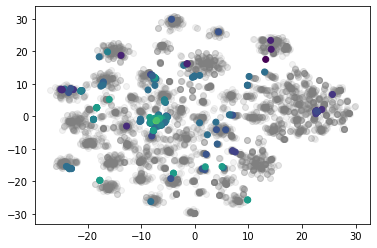

Element:  Au


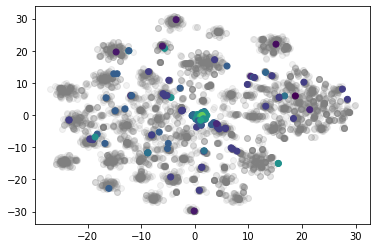

Element:  B


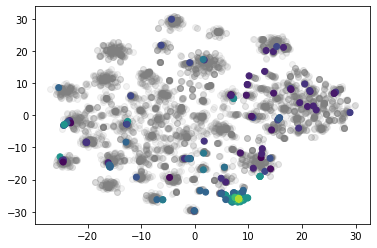

Element:  Ba


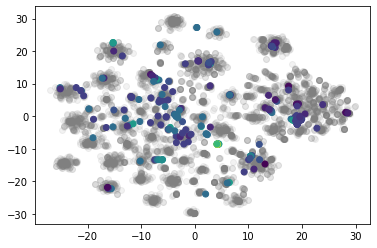

Element:  Be


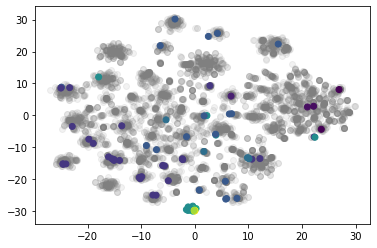

Element:  Bi


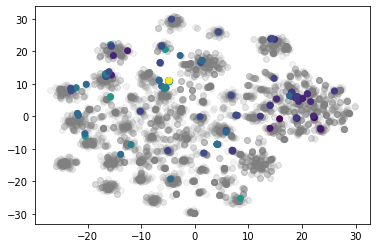

Element:  Br


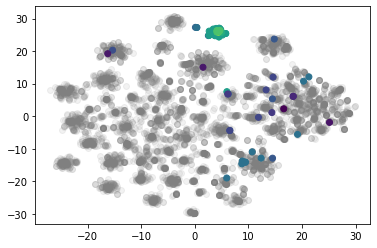

Element:  C


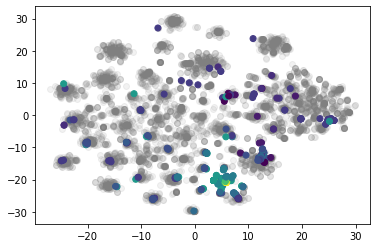

Element:  Ca


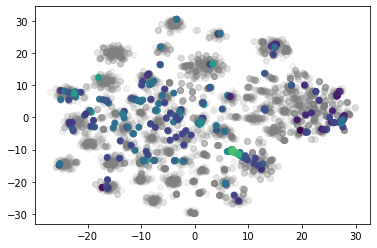

Element:  Cd


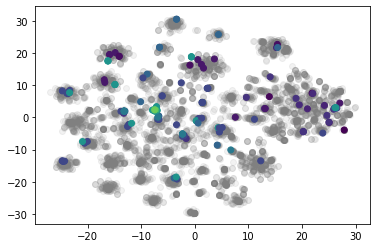

Element:  Ce


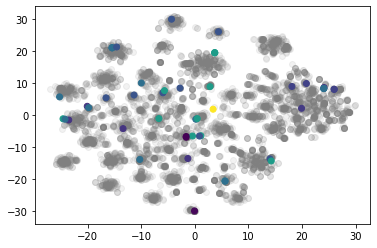

Element:  Cl


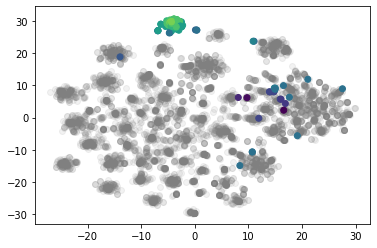

Element:  Co


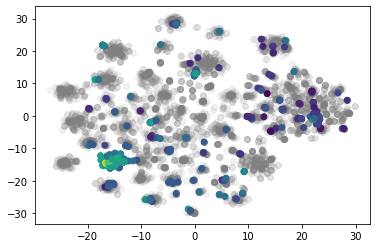

Element:  Cr


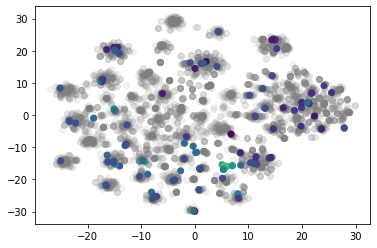

Element:  Cs


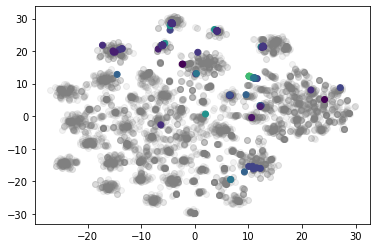

Element:  Cu


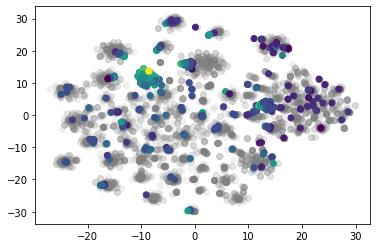

Element:  Dy


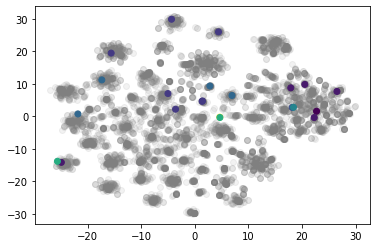

Element:  Er


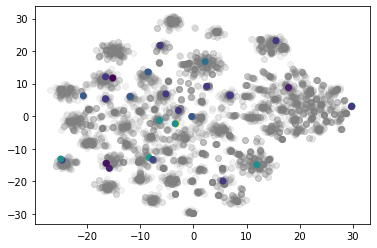

Element:  Eu


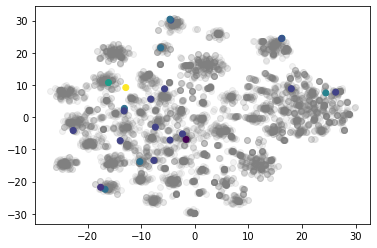

Element:  F


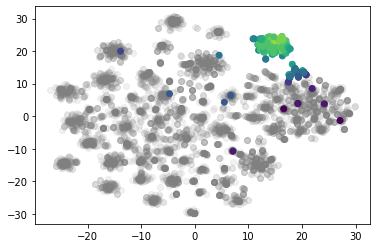

Element:  Fe


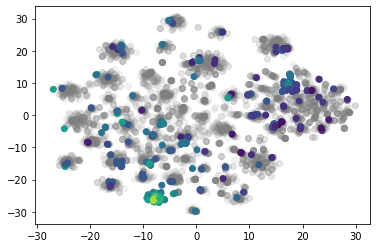

Element:  Ga


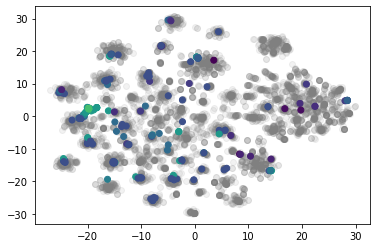

Element:  Gd


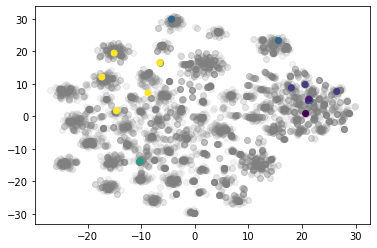

Element:  Ge


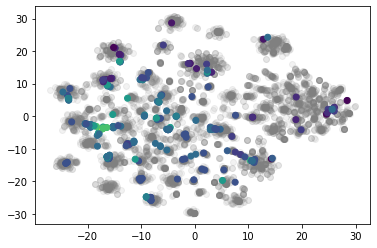

Element:  H


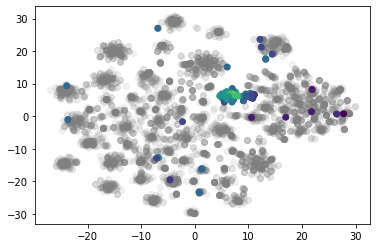

Element:  He


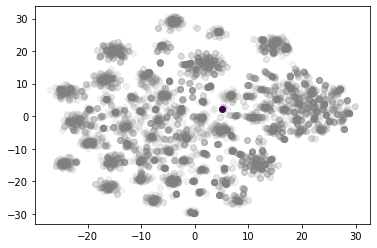

Element:  Hf


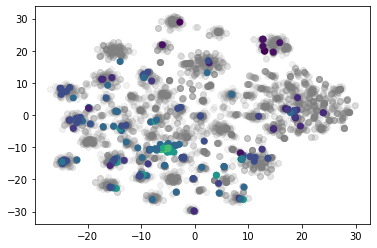

Element:  Hg


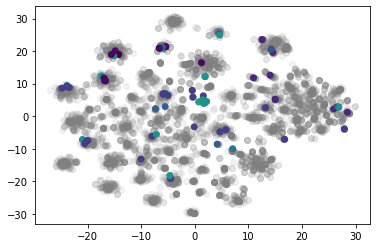

Element:  Ho


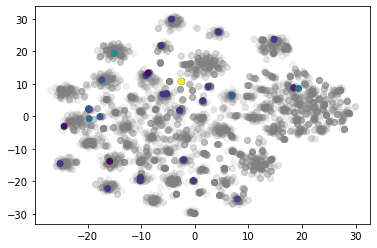

Element:  I


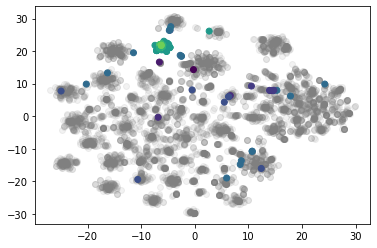

Element:  In


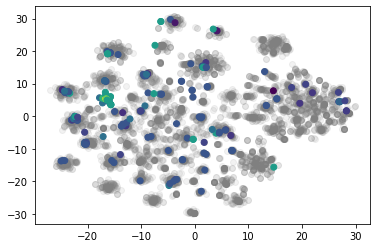

Element:  Ir


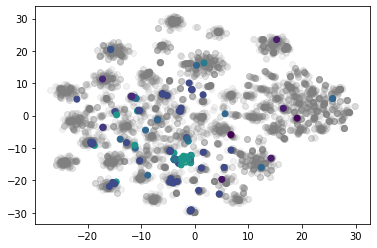

Element:  K


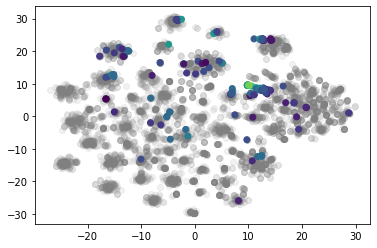

Element:  Kr


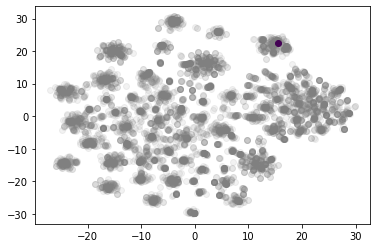

Element:  La


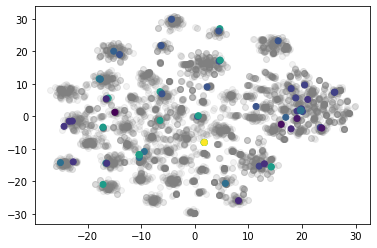

Element:  Li


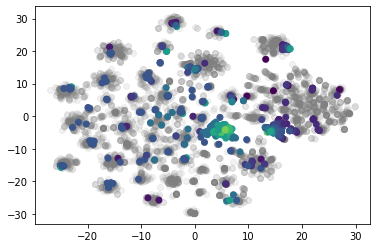

Element:  Lu


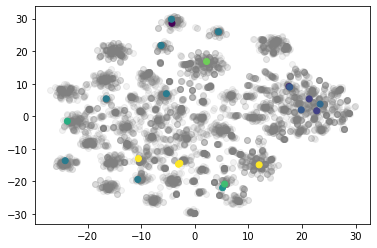

Element:  Mg


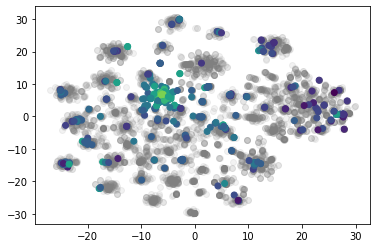

Element:  Mn


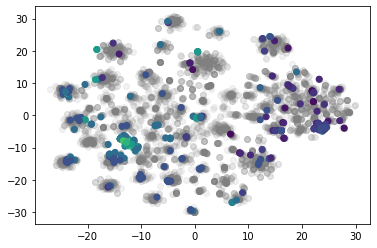

Element:  Mo


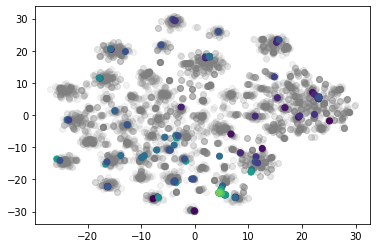

Element:  N


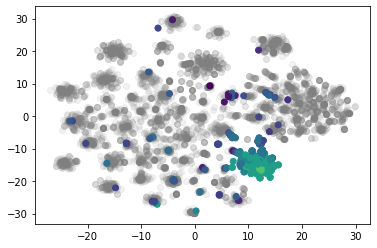

Element:  Na


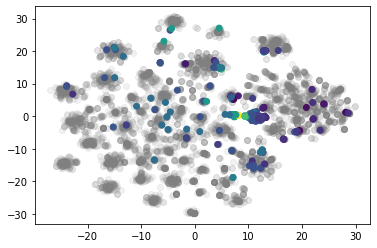

Element:  Nb


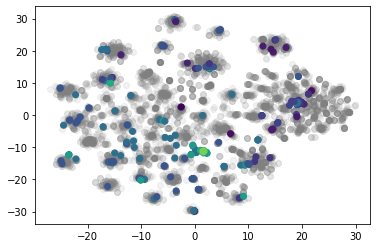

Element:  Nd


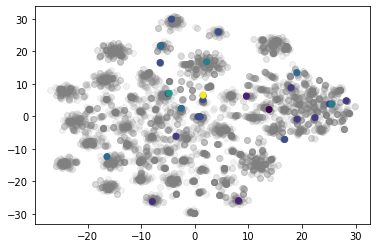

Element:  Ne


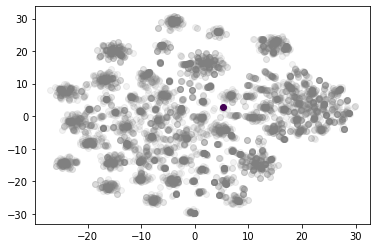

Element:  Ni


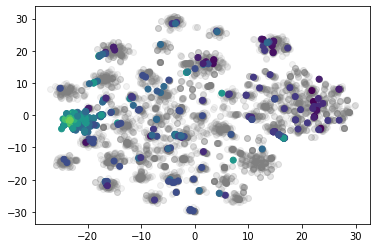

Element:  Np


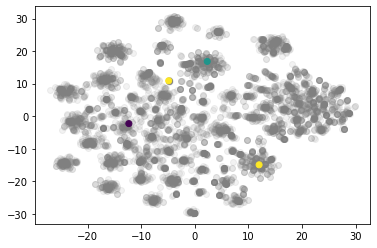

Element:  O


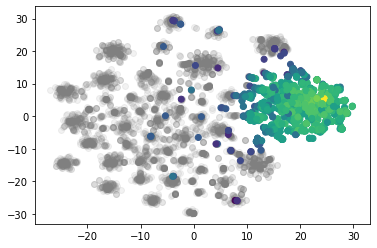

Element:  Os


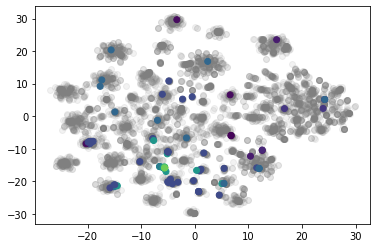

Element:  P


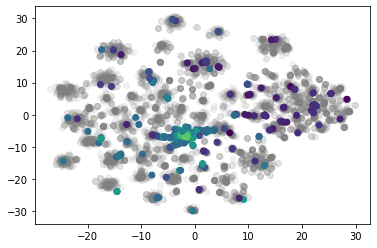

Element:  Pa


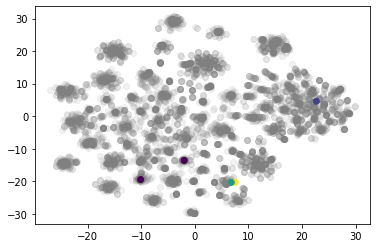

Element:  Pb


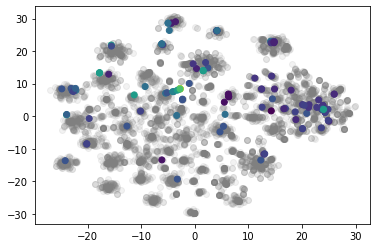

Element:  Pd


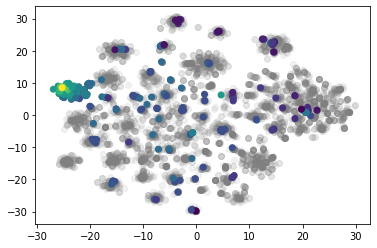

Element:  Pm


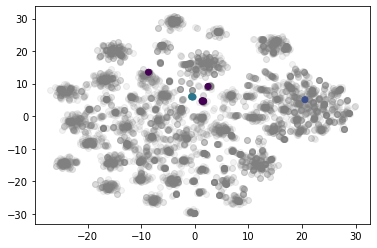

Element:  Pr


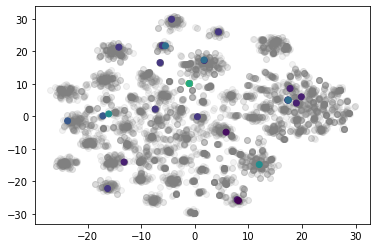

Element:  Pt


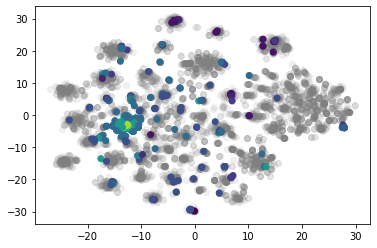

Element:  Pu


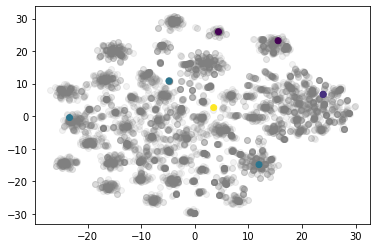

Element:  Rb


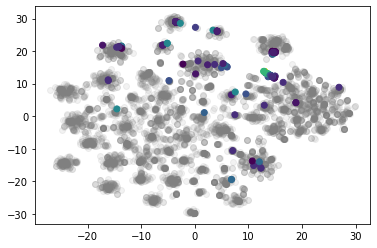

Element:  Re


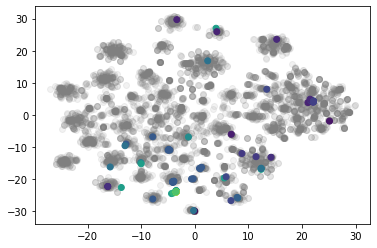

Element:  Rh


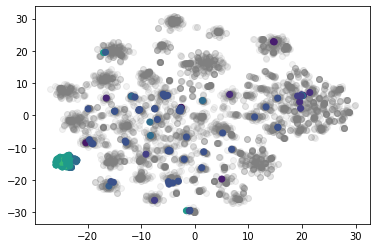

Element:  Ru


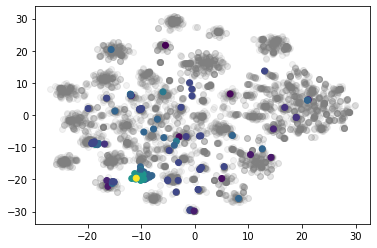

Element:  S


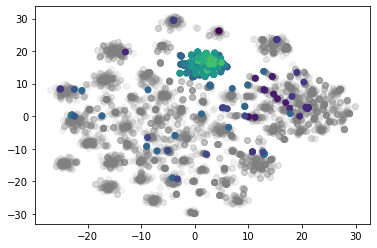

Element:  Sb


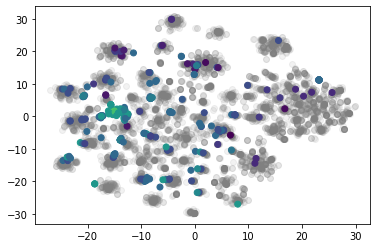

Element:  Sc


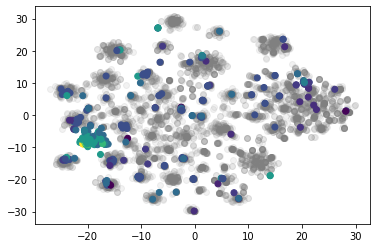

Element:  Se


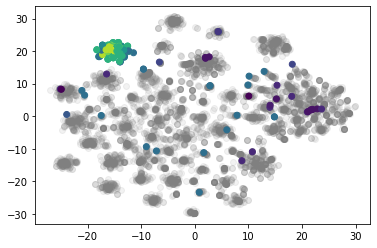

Element:  Si


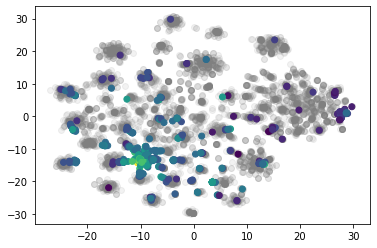

Element:  Sm


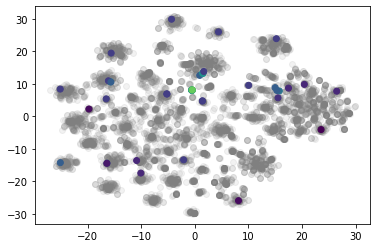

Element:  Sn


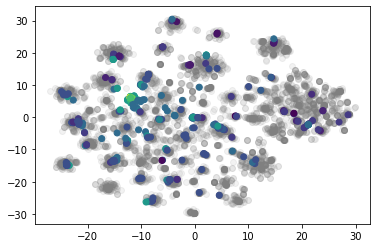

Element:  Sr


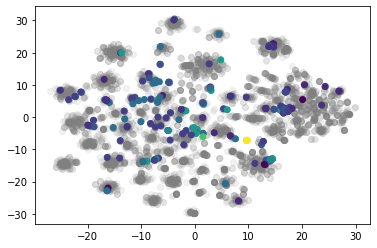

Element:  Ta


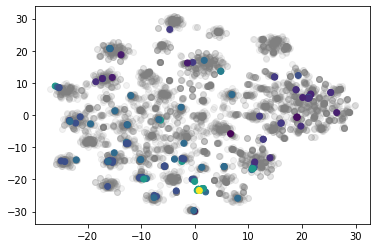

Element:  Tb


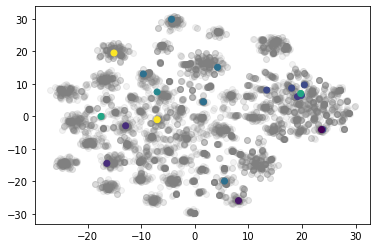

Element:  Tc


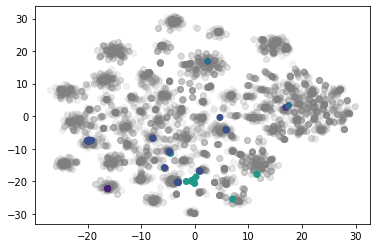

Element:  Te


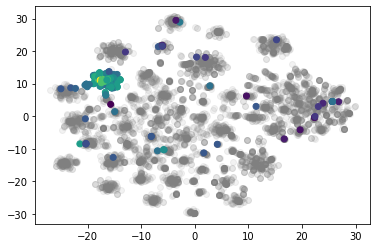

Element:  Th


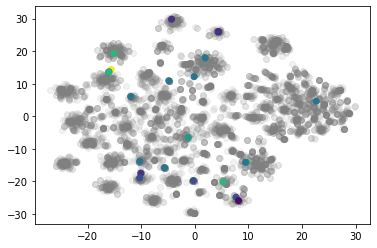

Element:  Ti


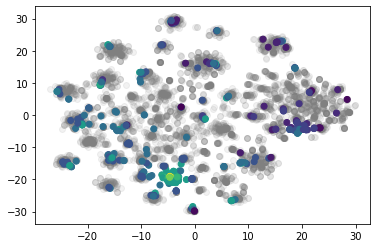

Element:  Tl


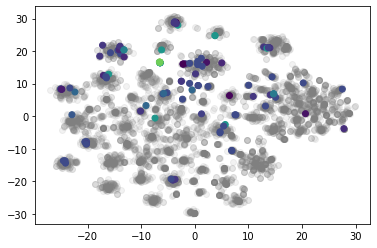

Element:  Tm


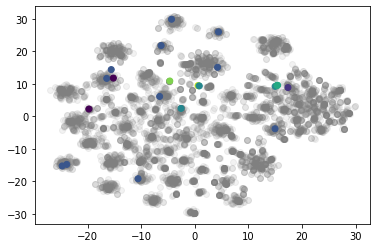

Element:  U


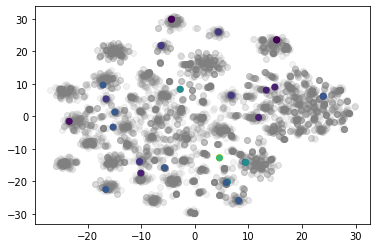

Element:  V


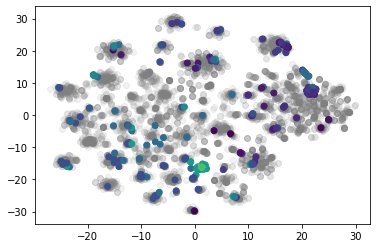

Element:  W


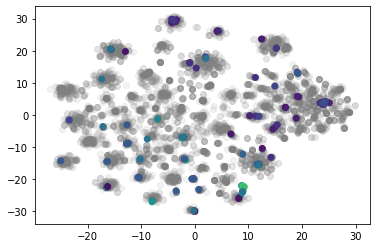

Element:  Xe


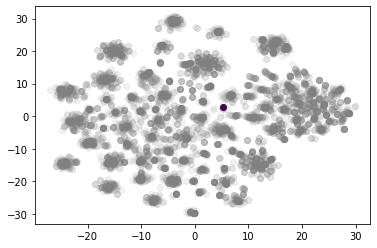

Element:  Y


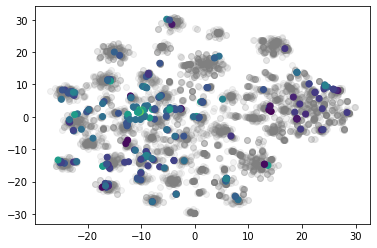

Element:  Yb


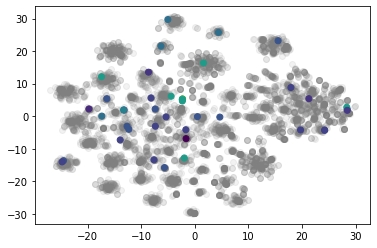

Element:  Zn


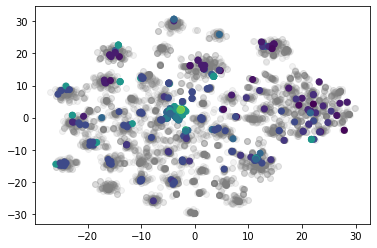

Element:  Zr


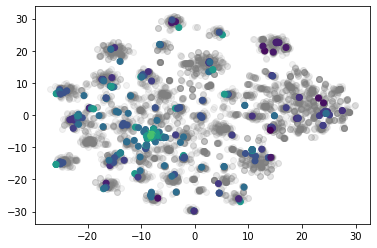

In [242]:
for p in elements:
    
    print('Element: ',p)
    #get the data points of which elements are active in a datapint
    element_masK = df[p]>0
    # all except the data with  'AC' in it
    plt.scatter(X_tr_tsne[~element_masK,0],X_tr_tsne[~element_masK,1],alpha=0.1,color='gray')
    #all data with element 'AC' in it and color it according to the percentage
    plt.scatter(X_tr_tsne[element_masK,0],X_tr_tsne[element_masK,1],c=np.log1p(df.loc[element_masK,p]))
    plt.show()

In [244]:
df['labels'] = labels

In [248]:
cluster_mean_elements = df.groupby('labels')[elements].mean()

In [250]:
cluster_mean_elements[cluster_mean_elements<0.025]=0

In [254]:
cluster_mean_elements.head()

,Ac,Ag,Al,Ar,As,Au,B,Ba,Be,Bi,...,Tl,Tm,U,V,W,Xe,Y,Yb,Zn,Zr
labels,,,,,,,,,,,,,,,,,,,,,
-1,0.0,0.0,0.026047,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [255]:
cluster_mean_composition.to_dict()

NameError: name 'cluster_mean_composition' is not defined

In [258]:
for lab in np.unique(labels):
    cluster_mean_composition = cluster_mean_elements.loc[lab]
    cluster_mean_composition = cluster_mean_composition[cluster_mean_composition>0]
    ave_comp_str = ''.join(['%s(%.3f)'%(k,v) for k,v in cluster_mean_composition.to_dict().items()])
    print(lab, ':', ave_comp_str)

-1 : Al(0.026)Cu(0.025)F(0.030)Li(0.029)N(0.033)Ni(0.027)O(0.142)S(0.040)Si(0.031)Ti(0.025)
0 : N(0.440)Sr(0.378)
1 : Pt(0.747)
2 : Mg(0.728)
3 : Fe(0.029)P(0.745)
4 : O(0.700)W(0.208)
5 : Na(0.341)O(0.487)
6 : Al(0.036)Co(0.027)Zr(0.703)
7 : Bi(0.052)Ca(0.634)In(0.028)
8 : O(0.626)Ti(0.297)
9 : Li(0.400)O(0.466)
10 : Li(0.775)Mg(0.027)Si(0.025)
11 : F(0.609)K(0.238)
12 : Al(0.041)Au(0.644)In(0.025)Li(0.035)Mg(0.025)Zn(0.025)
13 : Ga(0.701)Sc(0.030)Zr(0.032)
14 : C(0.031)Si(0.026)V(0.692)
15 : Ni(0.744)
16 : B(0.761)
17 : Ag(0.645)Al(0.030)Mg(0.051)S(0.038)
18 : F(0.819)
19 : Ca(0.043)Cd(0.036)Hg(0.606)Li(0.034)Mg(0.027)Pm(0.027)Sr(0.027)Y(0.056)
20 : Mn(0.271)O(0.610)
21 : Br(0.681)Cs(0.037)
22 : C(0.050)Fe(0.735)N(0.046)
23 : C(0.026)Os(0.031)Si(0.034)Ta(0.658)
24 : Zn(0.769)
25 : Al(0.351)O(0.592)
26 : Pd(0.753)
27 : H(0.670)Mg(0.059)
28 : Cs(0.044)I(0.686)
29 : Cu(0.345)O(0.507)
30 : Cu(0.758)
31 : Nb(0.036)Sc(0.054)Si(0.027)Tc(0.589)Ti(0.071)V(0.036)W(0.027)
32 : Pd(0.031)Ru(0.038

In [259]:
fig_size=4
ncol_max=5

Cluster: -1
-1 : Al(0.026) Cu(0.025) F(0.030) Li(0.029) N(0.033) Ni(0.027) O(0.142) S(0.040) Si(0.031) Ti(0.025)


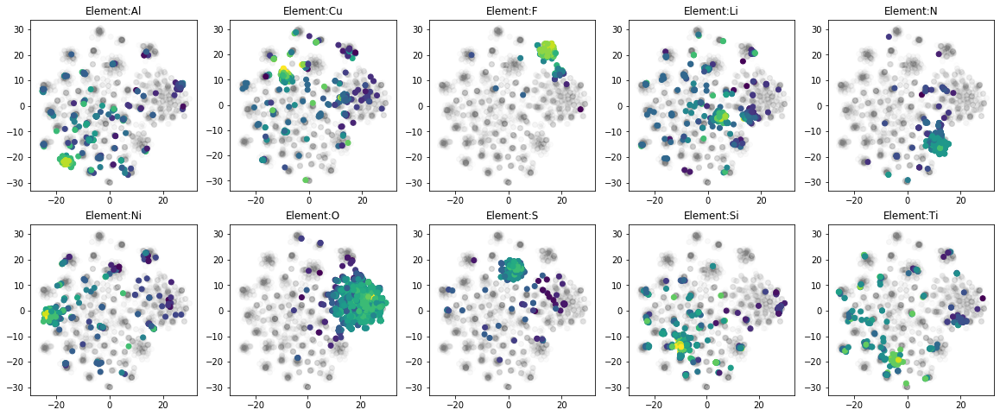

Cluster: 0
0 : N(0.440) Sr(0.378)


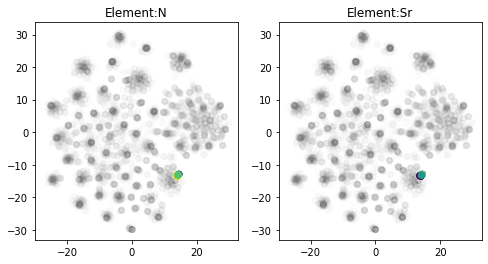

Cluster: 1
1 : Pt(0.747)


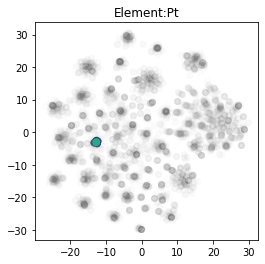

Cluster: 2
2 : Mg(0.728)


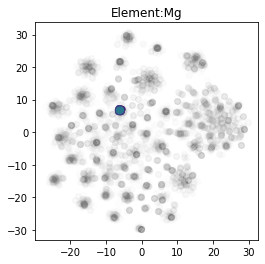

Cluster: 3
3 : Fe(0.029) P(0.745)


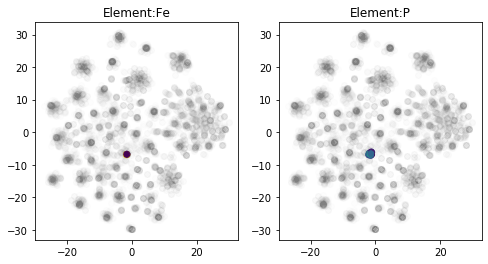

Cluster: 4
4 : O(0.700) W(0.208)


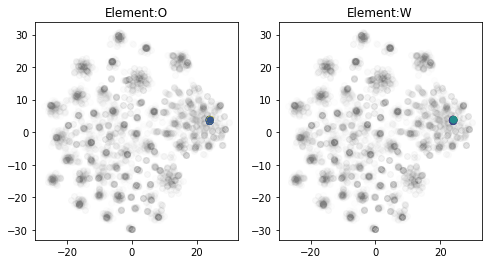

Cluster: 5
5 : Na(0.341) O(0.487)


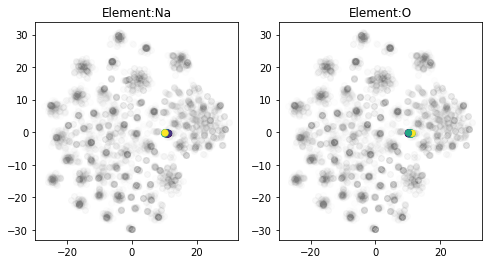

Cluster: 6
6 : Al(0.036) Co(0.027) Zr(0.703)


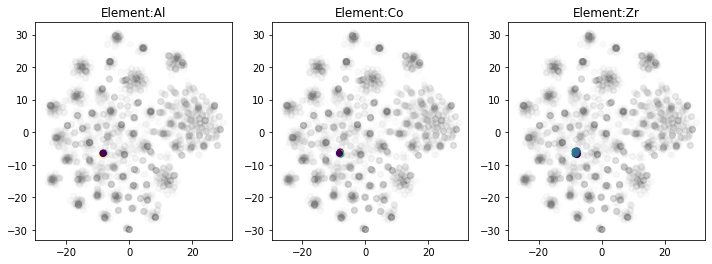

Cluster: 7
7 : Bi(0.052) Ca(0.634) In(0.028)


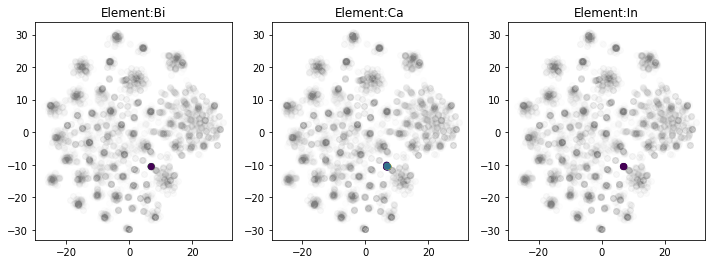

Cluster: 8
8 : O(0.626) Ti(0.297)


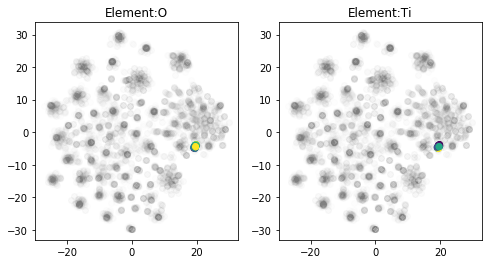

Cluster: 9
9 : Li(0.400) O(0.466)


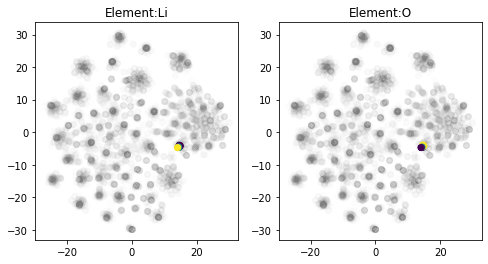

Cluster: 10
10 : Li(0.775) Mg(0.027) Si(0.025)


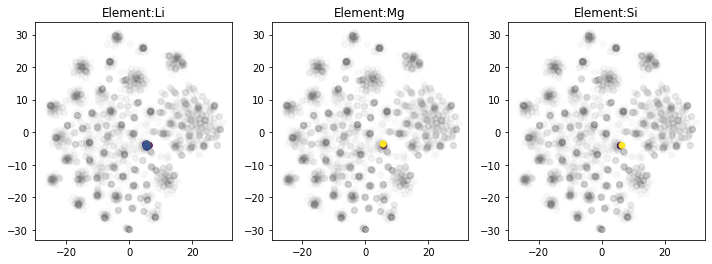

Cluster: 11
11 : F(0.609) K(0.238)


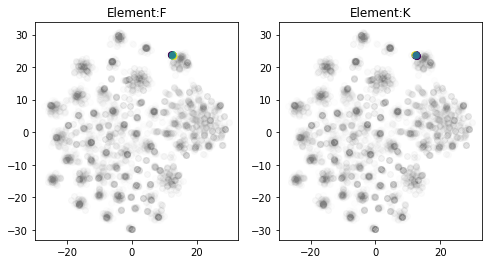

Cluster: 12
12 : Al(0.041) Au(0.644) In(0.025) Li(0.035) Mg(0.025) Zn(0.025)


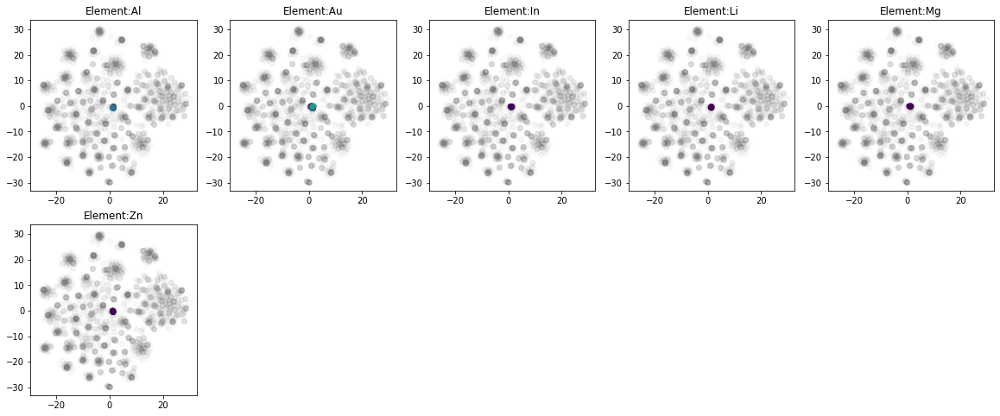

Cluster: 13
13 : Ga(0.701) Sc(0.030) Zr(0.032)


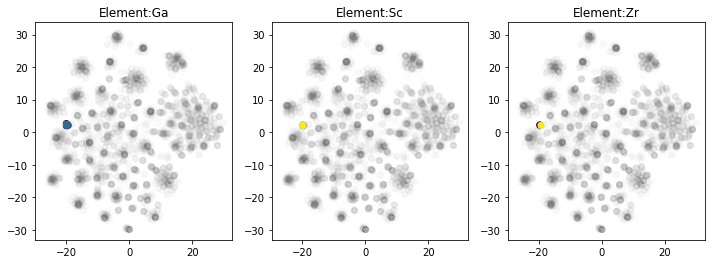

Cluster: 14
14 : C(0.031) Si(0.026) V(0.692)


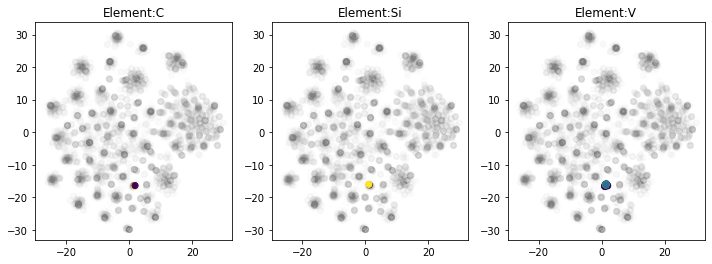

Cluster: 15
15 : Ni(0.744)


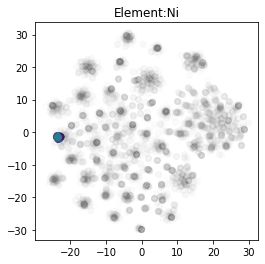

Cluster: 16
16 : B(0.761)


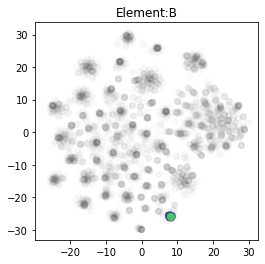

Cluster: 17
17 : Ag(0.645) Al(0.030) Mg(0.051) S(0.038)


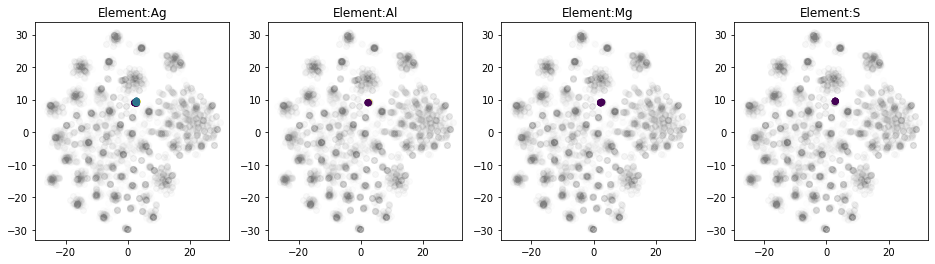

Cluster: 18
18 : F(0.819)


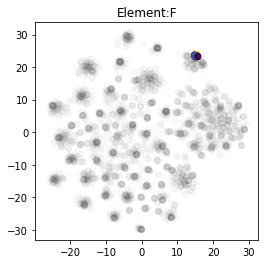

Cluster: 19
19 : Ca(0.043) Cd(0.036) Hg(0.606) Li(0.034) Mg(0.027) Pm(0.027) Sr(0.027) Y(0.056)


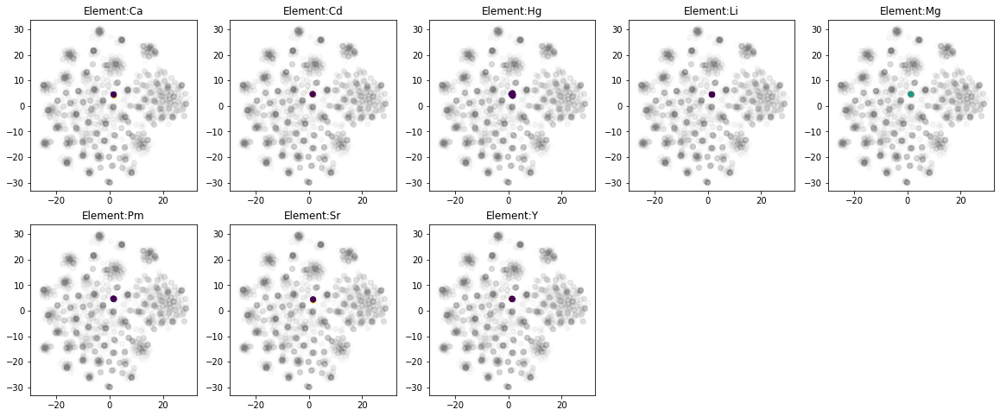

Cluster: 20
20 : Mn(0.271) O(0.610)


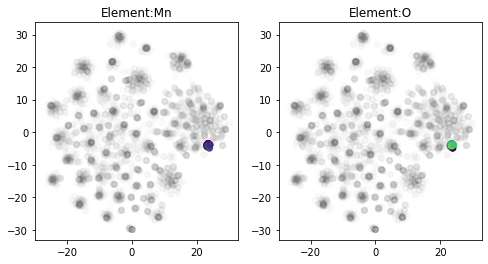

Cluster: 21
21 : Br(0.681) Cs(0.037)


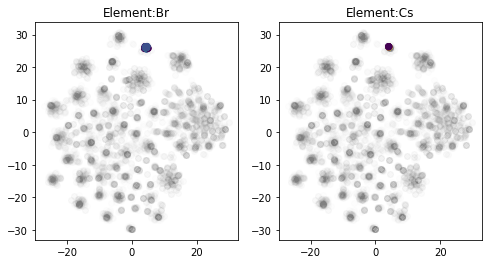

Cluster: 22
22 : C(0.050) Fe(0.735) N(0.046)


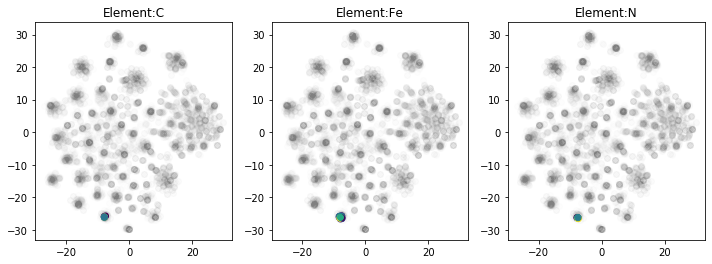

Cluster: 23
23 : C(0.026) Os(0.031) Si(0.034) Ta(0.658)


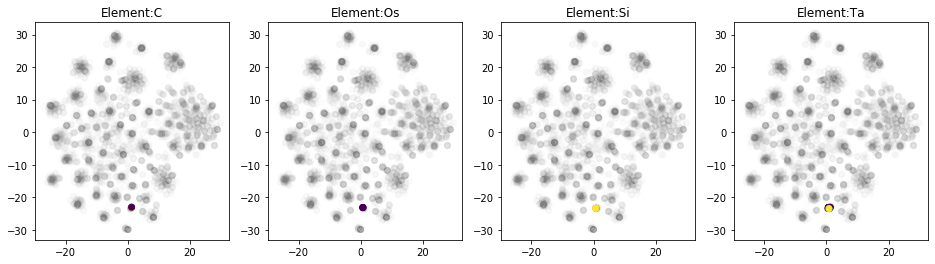

Cluster: 24
24 : Zn(0.769)


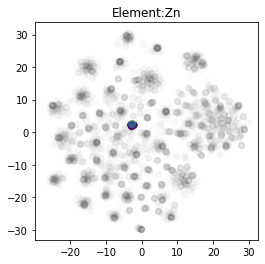

Cluster: 25
25 : Al(0.351) O(0.592)


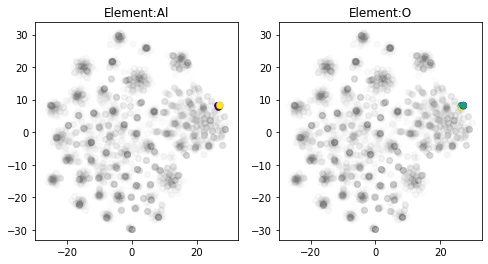

Cluster: 26
26 : Pd(0.753)


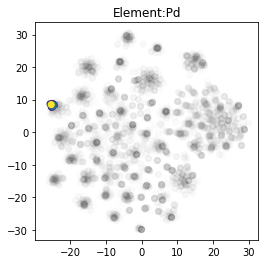

Cluster: 27
27 : H(0.670) Mg(0.059)


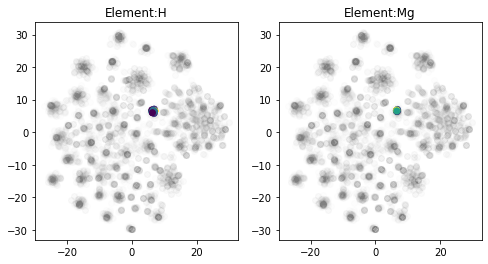

Cluster: 28
28 : Cs(0.044) I(0.686)


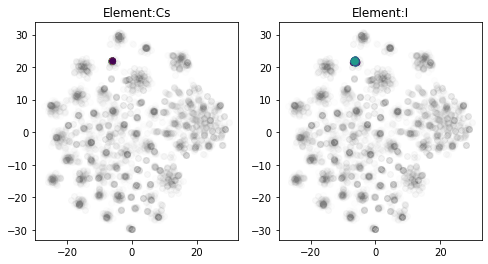

Cluster: 29
29 : Cu(0.345) O(0.507)


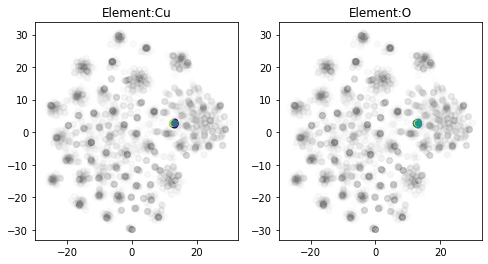

Cluster: 30
30 : Cu(0.758)


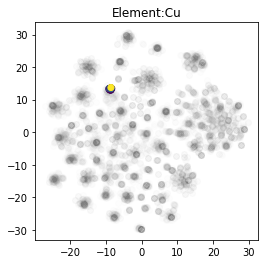

Cluster: 31
31 : Nb(0.036) Sc(0.054) Si(0.027) Tc(0.589) Ti(0.071) V(0.036) W(0.027)


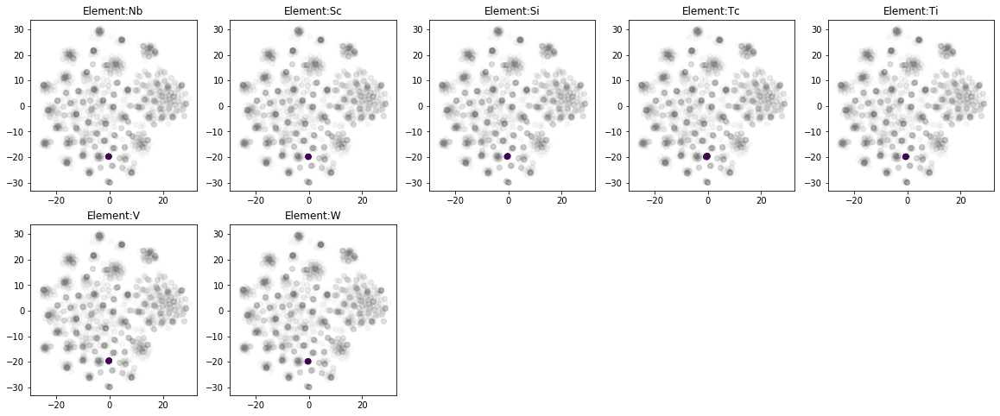

Cluster: 32
32 : Pd(0.031) Ru(0.038) Sn(0.714)


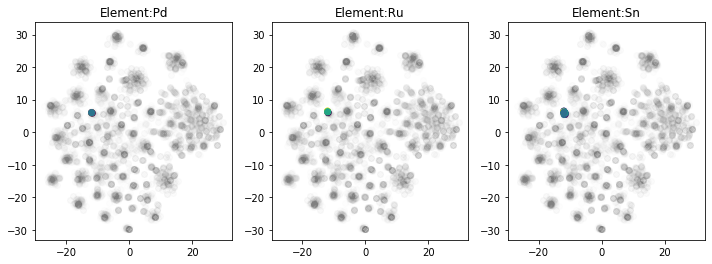

Cluster: 33
33 : Al(0.046) C(0.067) In(0.059) Mg(0.025) Sc(0.613) Te(0.027)


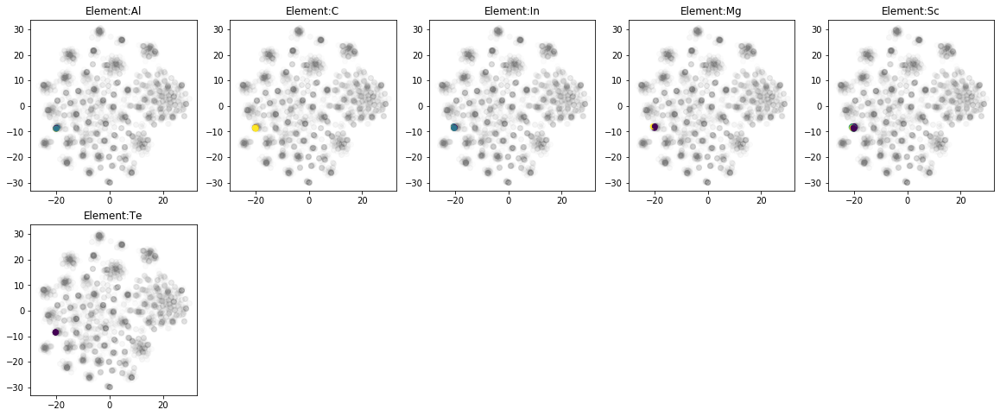

Cluster: 34
34 : O(0.642) Si(0.285)


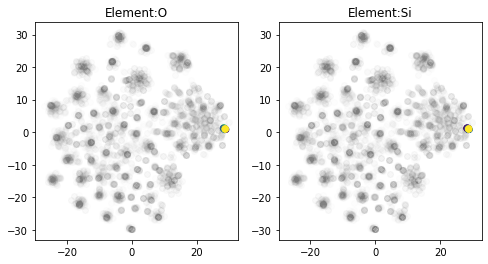

Cluster: 35
35 : C(0.026) Cr(0.673) N(0.027) Ti(0.034)


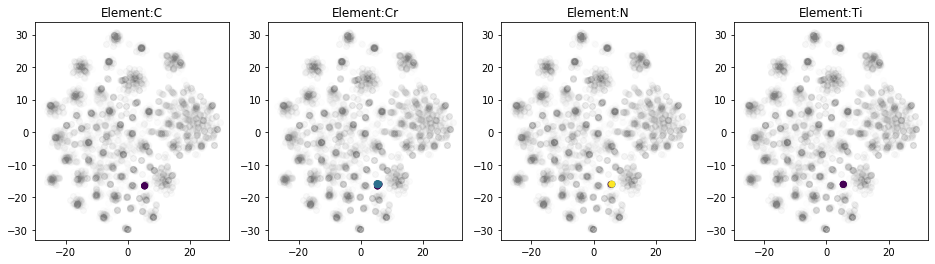

Cluster: 36
36 : Cu(0.330) S(0.500)


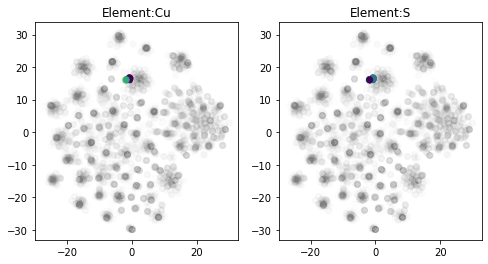

Cluster: 37
37 : Al(0.762)


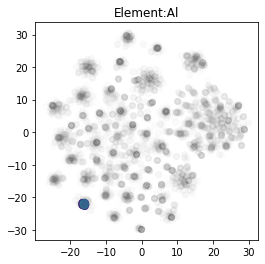

Cluster: 38
38 : Ca(0.451) N(0.423)


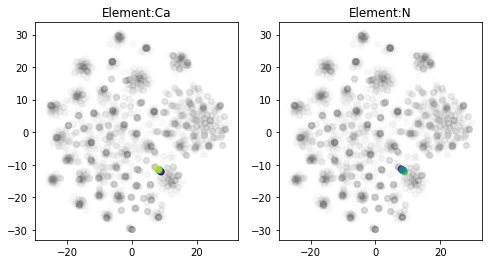

Cluster: 39
39 : Cu(0.320) Se(0.502)


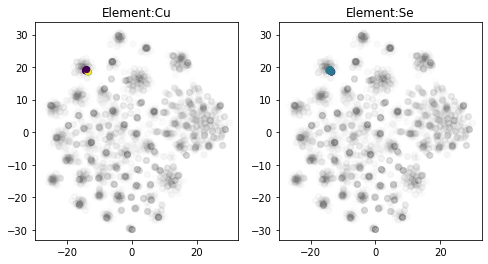

Cluster: 40
40 : Ba(0.237) O(0.592)


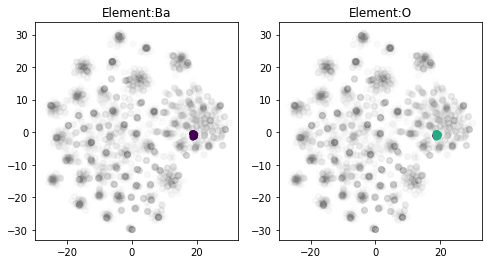

Cluster: 41
41 : F(0.754) Ni(0.026) Pb(0.034) Pd(0.029) Pt(0.031)


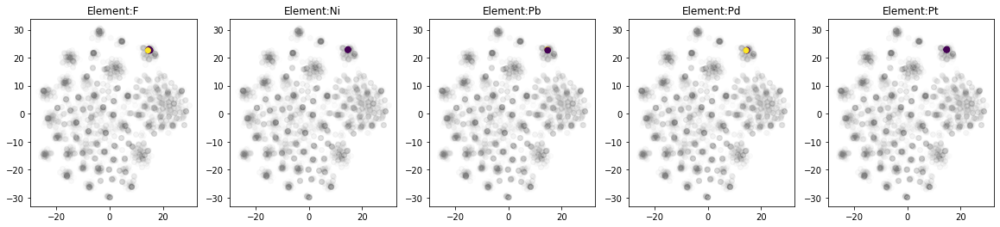

Cluster: 42
42 : Mg(0.028) Rh(0.620) Sc(0.064) Y(0.027)


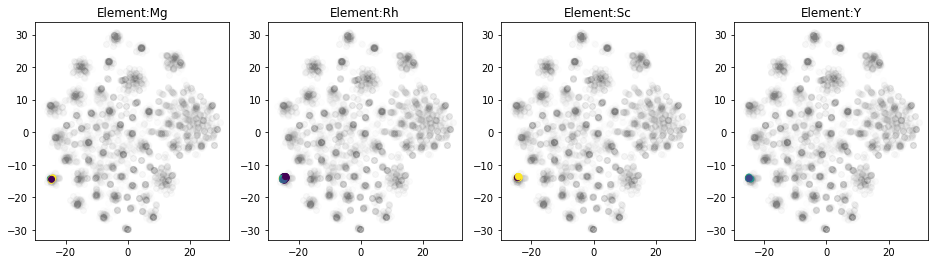

Cluster: 43
43 : As(0.653) Ge(0.097) Ni(0.026)


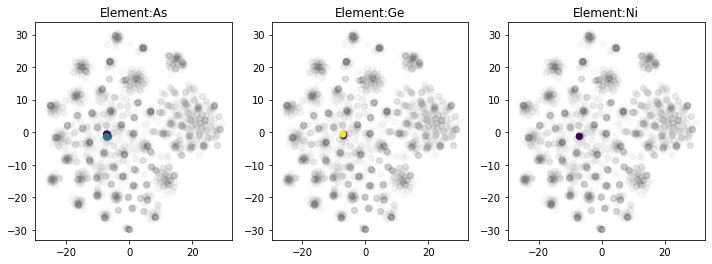

Cluster: 44
44 : Al(0.050) Os(0.610) Sc(0.043) Si(0.030) Ta(0.040) Ti(0.040) V(0.030)


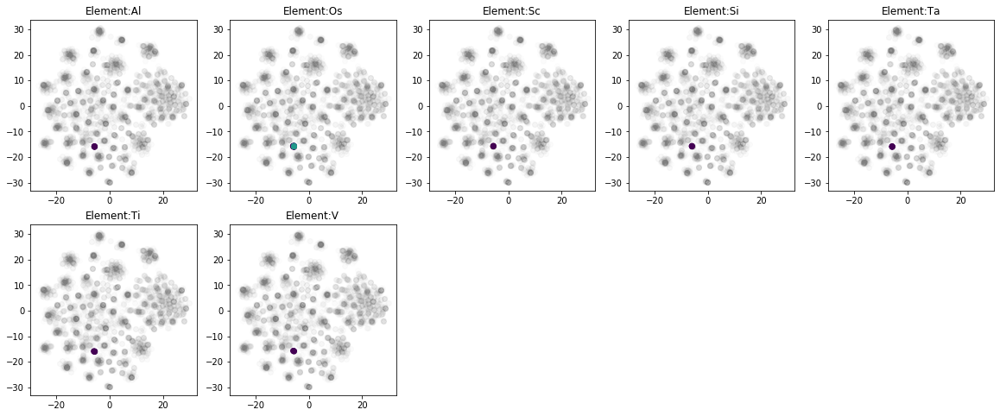

Cluster: 45
45 : Cl(0.623) Cs(0.190) Ti(0.047)


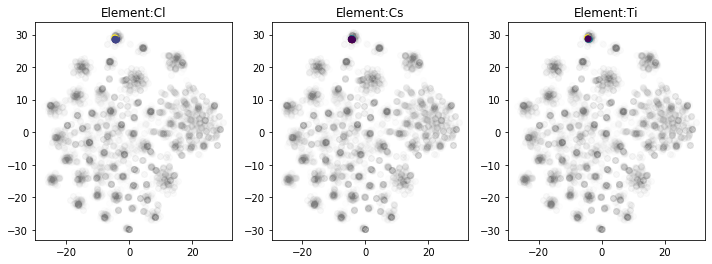

Cluster: 46
46 : Al(0.039) Ge(0.025) Nb(0.038) Ru(0.546) Sc(0.043) Ta(0.034) V(0.030)


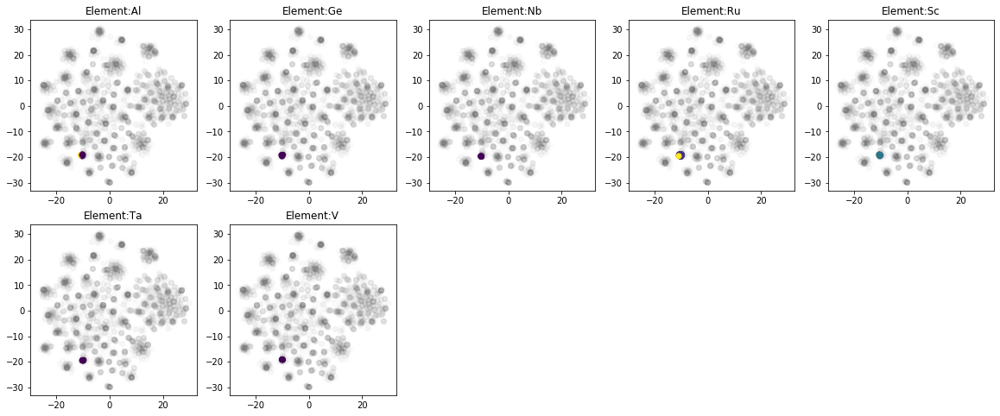

Cluster: 47
47 : Co(0.025) Cr(0.032) Sb(0.680)


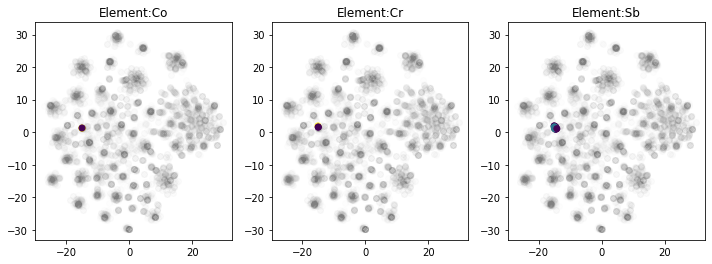

Cluster: 48
48 : Cl(0.749)


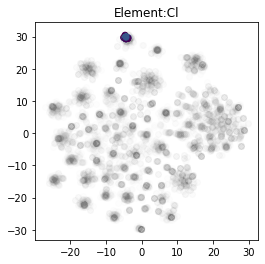

Cluster: 49
49 : F(0.653) Li(0.192) V(0.117)


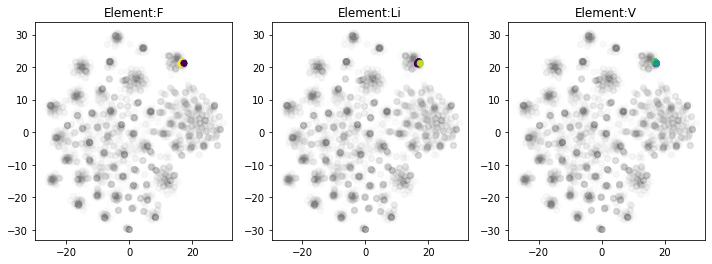

Cluster: 50
50 : Nb(0.222) O(0.664)


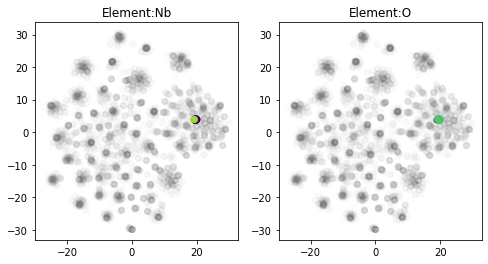

Cluster: 51
51 : Ir(0.595) Mg(0.054) Sc(0.034) Ti(0.029)


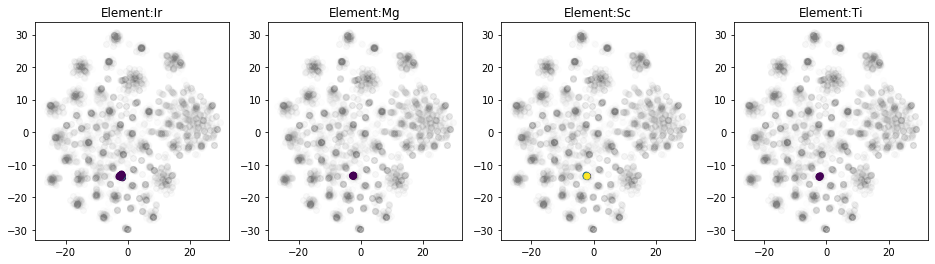

Cluster: 52
52 : Sn(0.047) Ti(0.740)


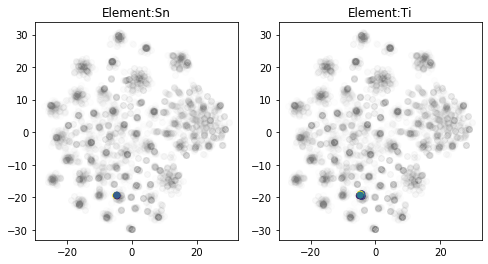

Cluster: 53
53 : Cr(0.039) In(0.029) Te(0.678)


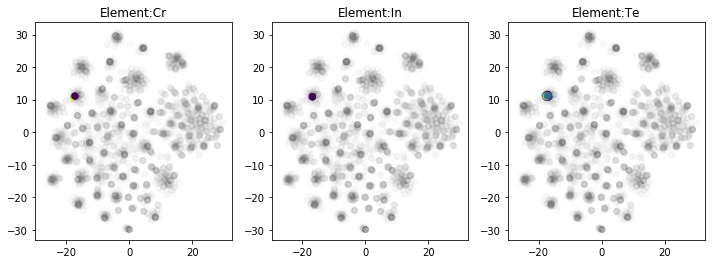

Cluster: 54
54 : Al(0.044) C(0.028) Mn(0.635) Ti(0.028)


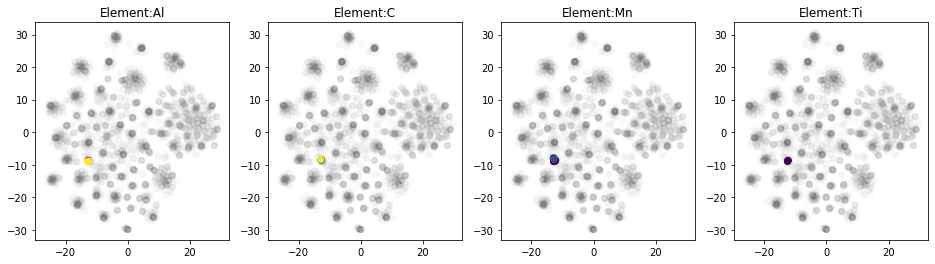

Cluster: 55
55 : Si(0.824)


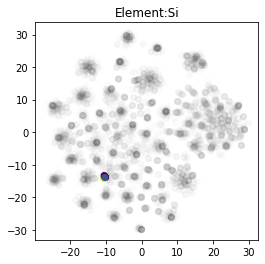

Cluster: 56
56 : Be(0.801)


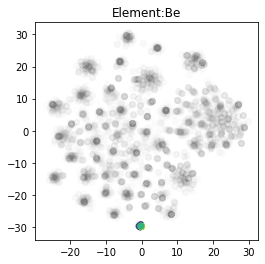

Cluster: 57
57 : In(0.633) Pd(0.033) Pt(0.039) Sr(0.038) Zr(0.030)


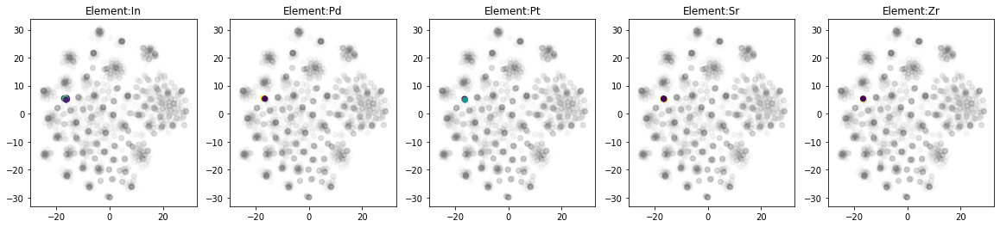

Cluster: 58
58 : Nb(0.707) Si(0.071)


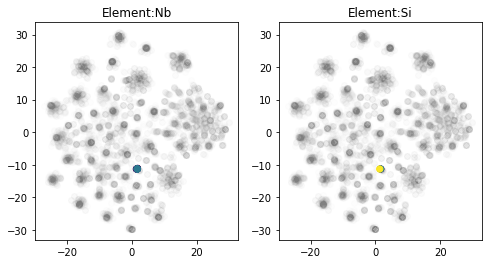

Cluster: 59
59 : Bi(0.687) Np(0.025) Pd(0.033) Pt(0.033) Pu(0.025) Sr(0.025) Tm(0.025) Zn(0.062)


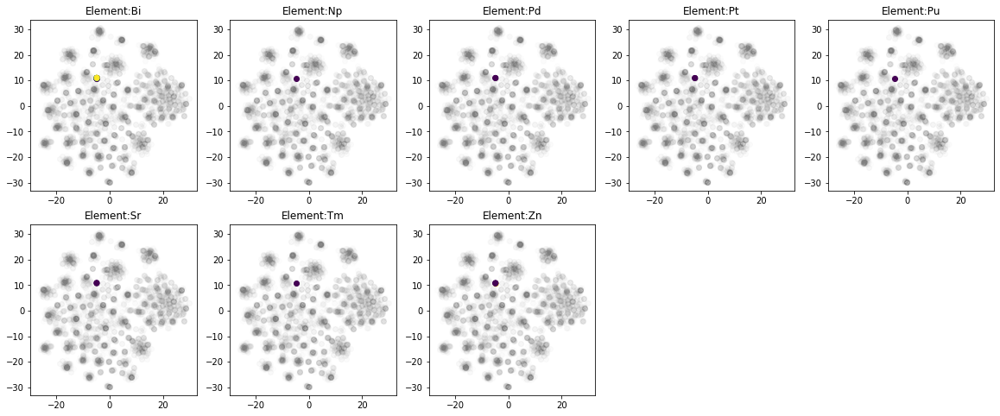

Cluster: 60
60 : Al(0.048) C(0.044) Ir(0.057) Ru(0.050) Y(0.576) Zn(0.029)


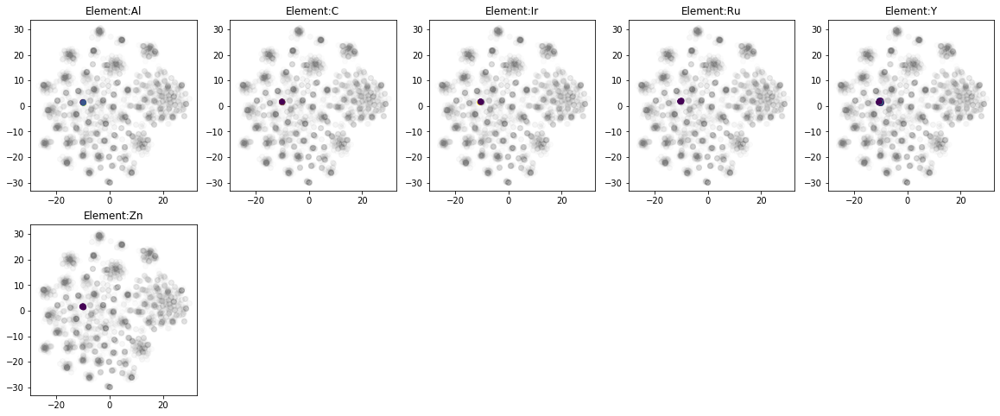

Cluster: 61
61 : O(0.654) V(0.235)


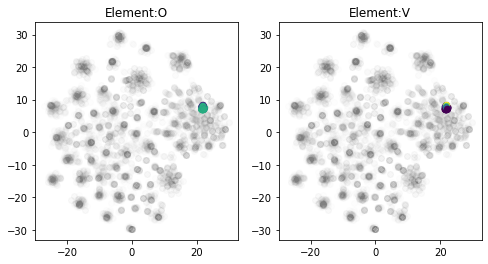

Cluster: 62
62 : Cl(0.640) K(0.057) Rb(0.093) Tl(0.034)


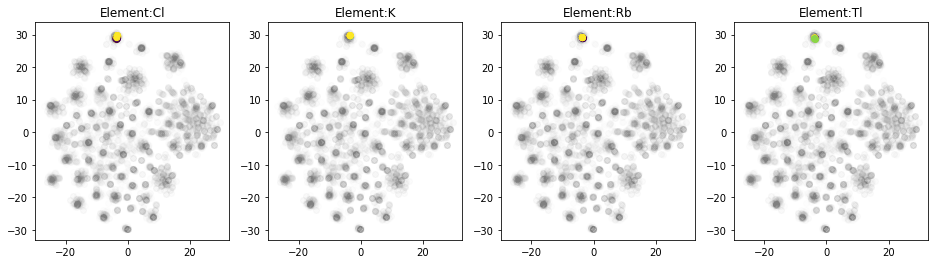

Cluster: 63
63 : Ag(0.052) Al(0.089) Cr(0.083) Mg(0.034) Se(0.567)


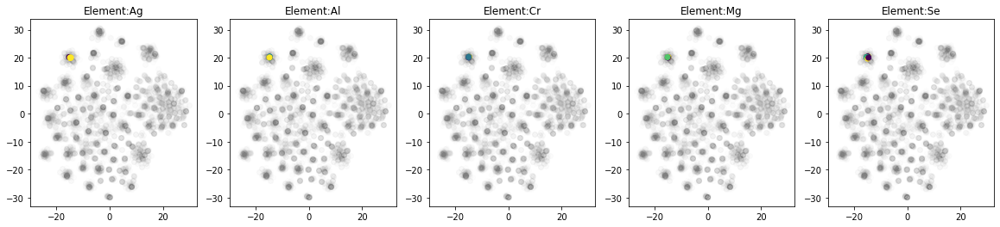

Cluster: 64
64 : Co(0.738) Ta(0.046)


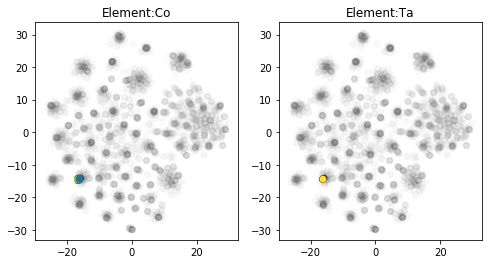

Cluster: 65
65 : Al(0.104) Co(0.507) Ga(0.115) Hf(0.056) Nb(0.035) Sc(0.031)


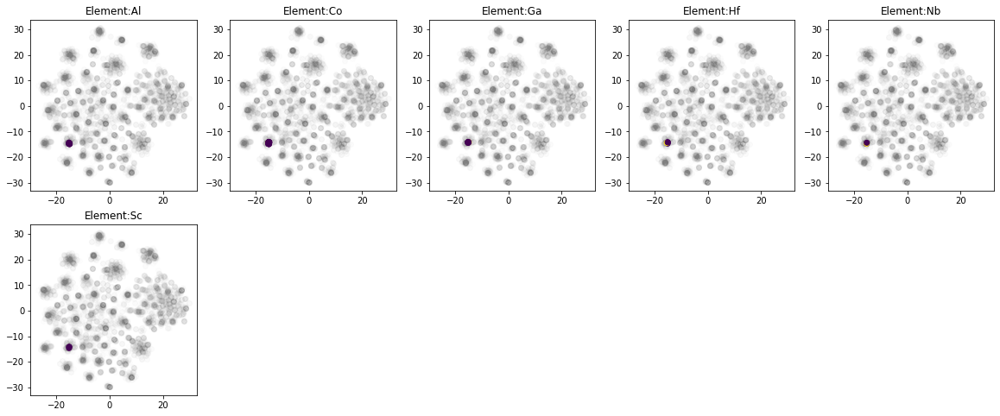

Cluster: 66
66 : Li(0.515) N(0.349)


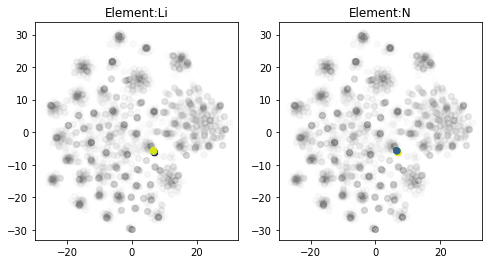

Cluster: 67
67 : O(0.580) Sr(0.245)


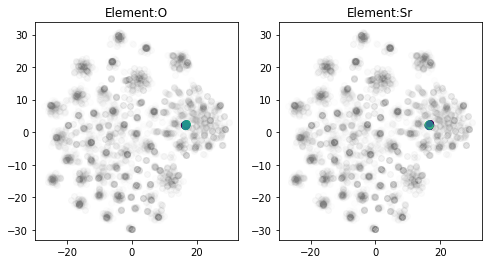

Cluster: 68
68 : Co(0.026) Hf(0.585) Ir(0.041) Os(0.035) Re(0.029)


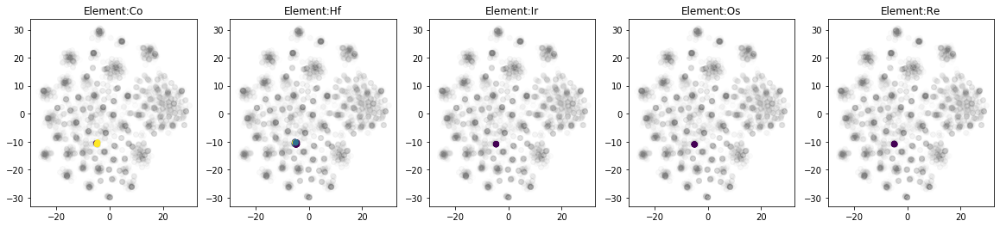

Cluster: 69
69 : C(0.810) Ca(0.048)


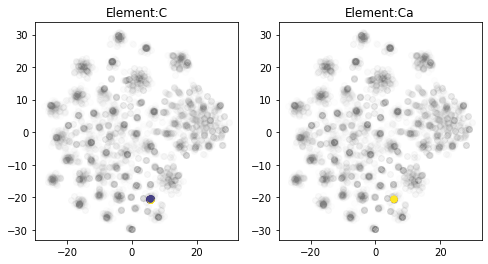

Cluster: 70
70 : Co(0.030) Ir(0.090) Li(0.030) Rh(0.030) Ru(0.140) Sc(0.500) Zn(0.030)


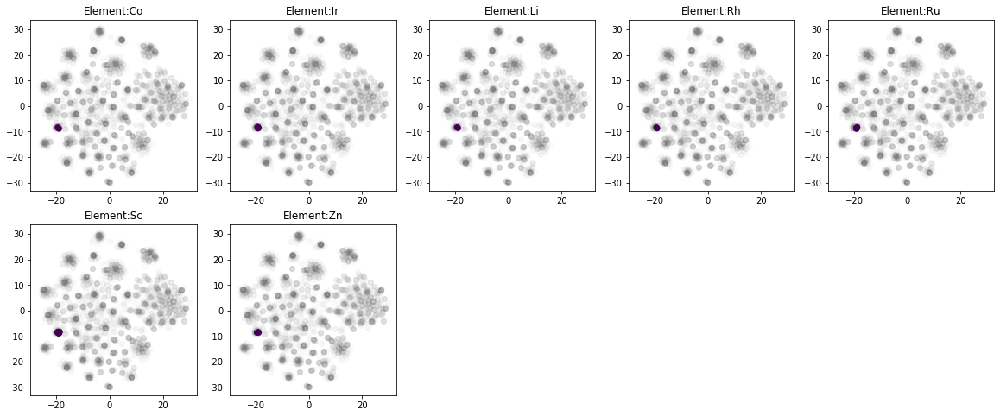

Cluster: 71
71 : Ag(0.057) Ga(0.057) Ni(0.034) Os(0.034) Sc(0.500) Tc(0.148)


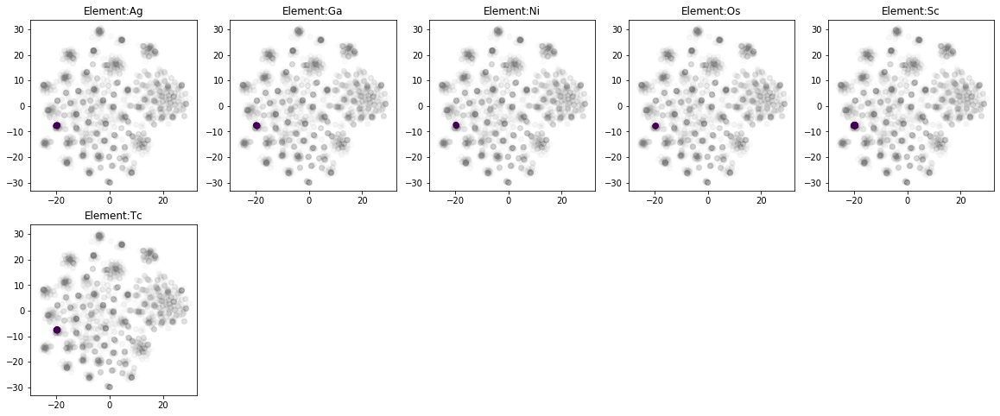

Cluster: 72
72 : Al(0.026) Cu(0.039) Ge(0.039) Hf(0.026) Mg(0.105) Mn(0.079) Rh(0.509) Sn(0.083) Ti(0.026)


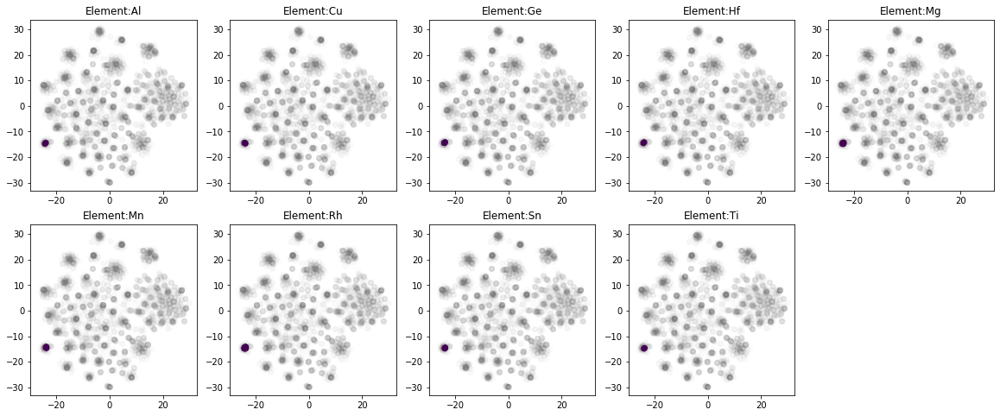

Cluster: 73
73 : Be(0.500) Co(0.053) Cu(0.053) Ir(0.079) Mn(0.026) Ni(0.053) Pd(0.039) Pt(0.105) Rh(0.053) Ru(0.026)


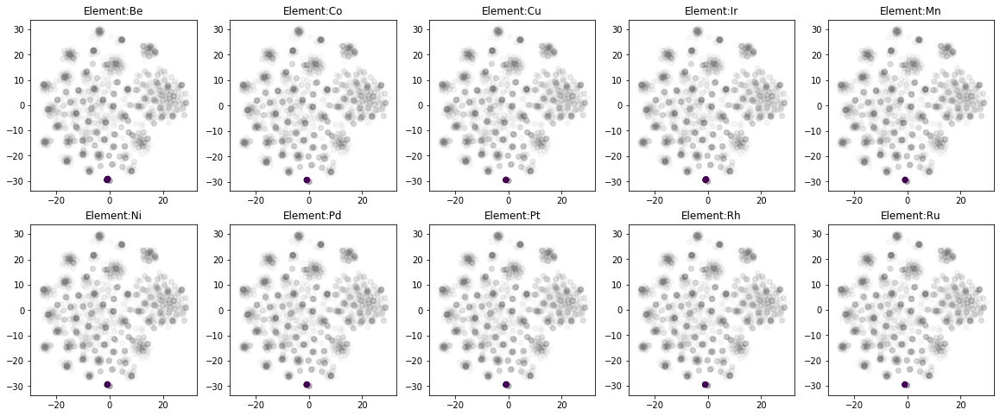

Cluster: 74
74 : Ca(0.058) Cd(0.648) Li(0.025) Mg(0.042) Pd(0.025) Pt(0.037) Rh(0.025) Y(0.054)


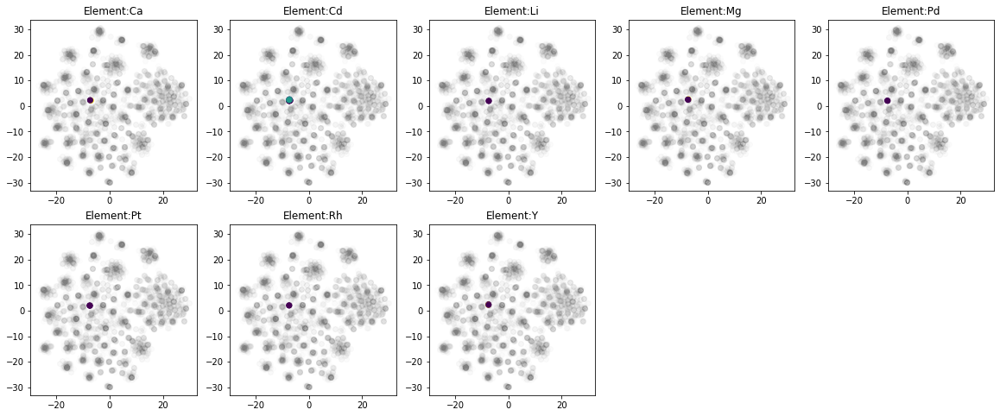

Cluster: 75
75 : Fe(0.237) O(0.593)


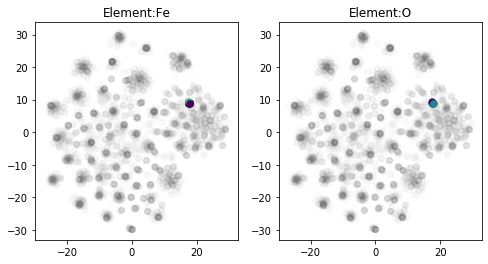

Cluster: 76
76 : Co(0.318) Li(0.026) O(0.584)


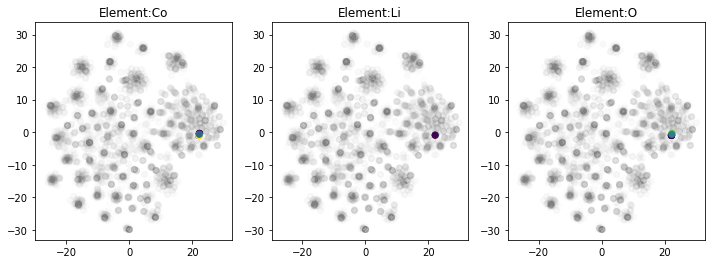

In [260]:
for lab in np.unique(labels):
    print("Cluster:",lab)
    label_mask = labels==lab
    cluster_mean_composition=cluster_mean_elements.loc[lab]
    cluster_mean_composition=cluster_mean_composition[cluster_mean_composition>0]
    ave_comp_str=" ".join(["%s(%.3f)"%(k,v) for k, v in cluster_mean_composition.to_dict().items()])
    print(lab,":", ave_comp_str)

    n_comp=len(cluster_mean_composition)
    if n_comp>=ncol_max:
        ncol = ncol_max
        nrow=n_comp//ncol + (1 if n_comp%ncol>0 else 0)
    else:
        nrow=1
        ncol=n_comp

    plt.figure(figsize=(ncol*fig_size,nrow*fig_size))
    for i,p in enumerate(cluster_mean_composition.index):
        ax=plt.subplot(nrow,ncol,i+1)
        element_mask = df[p]>0 
        cur_mask=(element_mask & label_mask)
        ax.scatter(X_tr_tsne[~cur_mask,0], X_tr_tsne[~cur_mask,1],alpha=0.01,color="gray")
        ax.scatter(X_tr_tsne[cur_mask,0], X_tr_tsne[cur_mask,1],c=np.log1p(df.loc[cur_mask,p]))    
        ax.set_title("Element:"+p)
        #plt.colorbar(ax=m_ax)
    plt.show()